# VILLABONA AMASA

In [157]:
import pandas as pd
import matplotlib.pyplot as plt

df = pd.read_csv('VILLABONA_AMASA_2023.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df = df.drop(['ID', 'Flow', 'Unknown'], axis=1)
df.head()

,Timestamp,Pressure
0,2023-01-01 00:10:00,1.939
1,2023-01-01 00:15:00,1.084
2,2023-01-01 00:20:00,1.353
3,2023-01-01 00:25:00,0.705
4,2023-01-01 00:30:00,1.426


In [158]:
numeric_cols = df[['Pressure']]
numeric_cols.set_index(df['Timestamp'], inplace=True)

# Resampling the data to a 5-minute interval using mean
df = numeric_cols.resample('5T').mean()

df['Timestamp'] = df.index



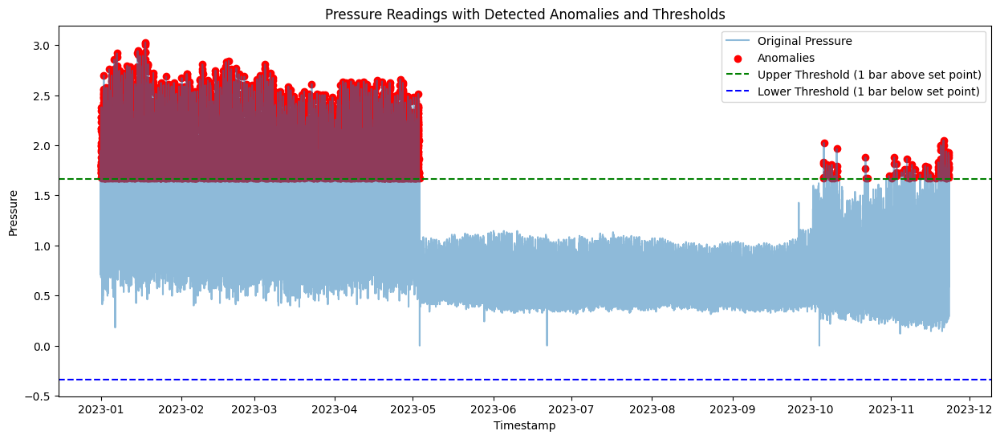

Set Point: 0.6630241920842411
Suma Total de Anomalías: 7535


In [159]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculating the mean within the correct range as set point
set_point = df.loc['2023-05-01':'2023-09-30', 'Pressure'].mean()

# Defining operational thresholds
upper_threshold = set_point + 1  # 1 bar above the set point
lower_threshold = set_point - 1  # 1 bar below the set point
df = df.dropna()
# Identifying points outside the threshold
df['Anomalies'] = ((df['Pressure'] > upper_threshold) | (df['Pressure'] < lower_threshold))

# Plotting the results with threshold lines
plt.figure(figsize=(15, 6))
plt.plot(df.index, df['Pressure'], label='Original Pressure', alpha=0.5)

# Highlight the anomalies
anomalies = df[df['Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='red', label='Anomalies')

# Add horizontal lines for the upper and lower threshold
plt.axhline(y=upper_threshold, color='green', linestyle='--', label='Upper Threshold (1 bar above set point)')
plt.axhline(y=lower_threshold, color='blue', linestyle='--', label='Lower Threshold (1 bar below set point)')

plt.title('Pressure Readings with Detected Anomalies and Thresholds')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()

# Print the set point for reference
print("Set Point:", set_point)
suma_anomalias = df['Anomalies'].sum()

print(f"Suma Total de Anomalías: {suma_anomalias}")

Maybe the code below needs to be ran couple of times to search the best quantiles

Epoch 1/50
139/139 [==============================] - 1s 2ms/step - loss: 1.2075 - val_loss: 0.7482
Epoch 2/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0683 - val_loss: 0.7397
Epoch 3/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0669 - val_loss: 0.7394
Epoch 4/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0667 - val_loss: 0.7394
Epoch 5/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0666 - val_loss: 0.7394
Epoch 6/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0665 - val_loss: 0.7394
Epoch 7/50
139/139 [==============================] - 0s 906us/step - loss: 1.0664 - val_loss: 0.7394
Epoch 8/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0663 - val_loss: 0.7394
Epoch 9/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0661 - val_loss: 0.7394
Epoch 10/50
139/139 [==============================] - 0s 1ms/step - loss: 1.0660 - val_loss: 0.73

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\1474421663.py:81: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\1474421663.py:82: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



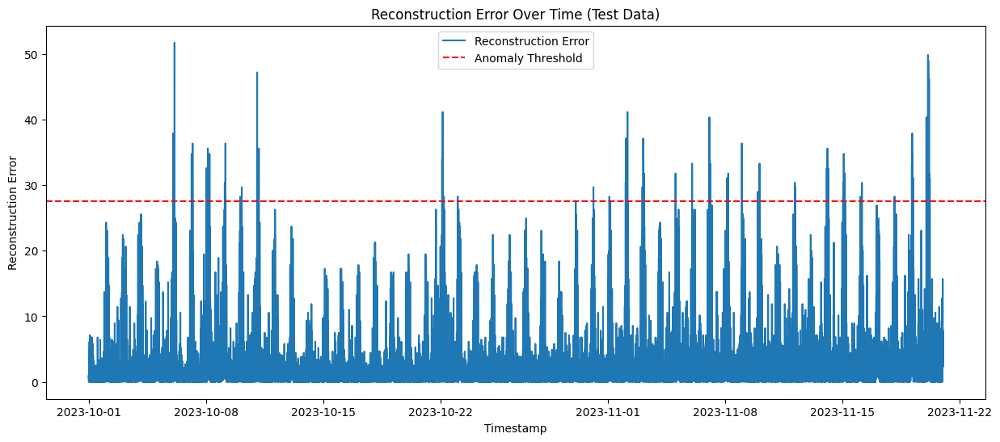

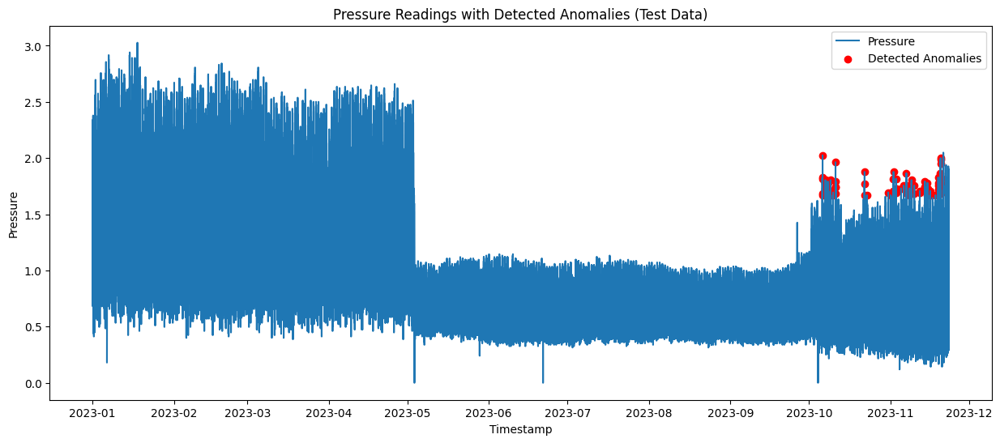

In [160]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2023-05-01':'2023-10-01']
val_data = resampled_df['2023-01-01':'2023-05-30']
test_data = resampled_df['2023-10-01':'2023-11-20']

scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])


val_pressure_scaled = scaler.transform(val_data[['Pressure']])
test_pressure_scaled = scaler.transform(test_data[['Pressure']])


input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2 

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the validation set and calculate MSE
val_predictions = autoencoder.predict(val_pressure_scaled)
val_mse = np.mean(np.power(val_pressure_scaled - val_predictions, 2), axis=1)

# Extract true labels for the same range as val_data
true_labels = df.loc[val_data.index, 'Anomalies'].values

# Define a range of potential quantiles to search
quantiles = np.linspace(0.80, 0.999, 100)

best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    threshold = np.quantile(val_mse, quantile)
    predicted_anomalies = val_mse > threshold

    # Calculate the F1 score
    f1 = f1_score(true_labels, predicted_anomalies)
    
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")

# Use the best quantile to set the mse_threshold on the test set
best_mse_threshold = np.quantile(val_mse, best_quantile)

# Predict on the test set
test_predictions = autoencoder.predict(test_pressure_scaled)
test_mse = np.mean(np.power(test_pressure_scaled - test_predictions, 2), axis=1)
test_data['Reconstruction_Error'] = test_mse
test_data['Predicted_Anomalies'] = test_mse > best_mse_threshold

plt.figure(figsize=(15, 6))
plt.plot(test_data.index, test_data['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=best_mse_threshold, color='r', linestyle='--', label='Anomaly Threshold')
plt.title('Reconstruction Error Over Time (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction Error')
plt.legend()
plt.show()

plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = test_data[test_data['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Detected Anomalies')
plt.title('Pressure Readings with Detected Anomalies (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()



In [161]:
import pandas as pd
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score, matthews_corrcoef

test_true_labels = df.loc[test_data.index, 'Anomalies']

# Check if the shapes match
if test_true_labels.shape[0] != test_data.shape[0]:
    raise ValueError("Mismatch in the number of rows between test data and true labels.")

# Ensure binary format and handle NaN values
test_true_labels = test_true_labels.fillna(0).astype(int)
test_data['Predicted_Anomalies'] = test_data['Predicted_Anomalies'].fillna(0).astype(int)

TN, FP, FN, TP = confusion_matrix(test_true_labels, test_data['Predicted_Anomalies']).ravel()

precision = precision_score(test_true_labels, test_data['Predicted_Anomalies'])
recall = recall_score(test_true_labels, test_data['Predicted_Anomalies'])
f1 = f1_score(test_true_labels, test_data['Predicted_Anomalies'])
accuracy = accuracy_score(test_true_labels, test_data['Predicted_Anomalies'])
mcc = matthews_corrcoef(test_true_labels, test_data['Predicted_Anomalies'])
error_rate = (FP + FN) / (TP + FP + FN + TN)

print("Confusion Matrix:")
print(f"True Positives (TP): {TP}")
print(f"False Positives (FP): {FP}")
print(f"True Negatives (TN): {TN}")
print(f"False Negatives (FN): {FN}")
print("\nMetrics:")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")
print(f"Accuracy: {accuracy:.2f}")
print(f"Matthews Correlation Coefficient (MCC): {mcc:.2f}")
print(f"Error Rate: {error_rate:.2f}")

sum_true_anomalies = test_true_labels.sum()
sum_predicted_anomalies = test_data['Predicted_Anomalies'].sum()

print(f"Sum of True Anomalies in Test Range: {sum_true_anomalies}")
print(f"Sum of Predicted Anomalies in Test Range: {sum_predicted_anomalies}")


Confusion Matrix:
True Positives (TP): 81
False Positives (FP): 0
True Negatives (TN): 14607
False Negatives (FN): 0

Metrics:
Precision: 1.00
Recall: 1.00
F1 Score: 1.00
Accuracy: 1.00
Matthews Correlation Coefficient (MCC): 1.00
Error Rate: 0.00
Sum of True Anomalies in Test Range: 81
Sum of Predicted Anomalies in Test Range: 81


C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\2913829944.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [162]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
# Drop rows with NaN values in resampled_df
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2023-05-01':'2023-09-30']

# Scale the 'Pressure' values of normal_data
scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])

# Save the scaler to a file
joblib.dump(scaler, 'scaler_reductor6.save')

['scaler_reductor6.save']

Maybe the code below needs to be ran couple of times to flag the anomalies correclty

Epoch 1/50
138/138 [==============================] - 1s 2ms/step - loss: 1.3997 - val_loss: 0.7317
Epoch 2/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0715 - val_loss: 0.7167
Epoch 3/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 4/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 5/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 6/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 7/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 8/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 9/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167
Epoch 10/50
138/138 [==============================] - 0s 1ms/step - loss: 1.0709 - val_loss: 0.7167

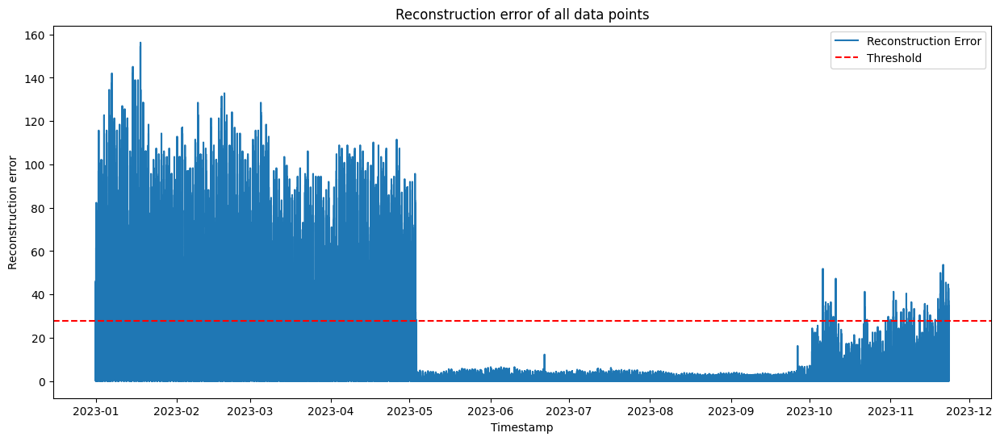

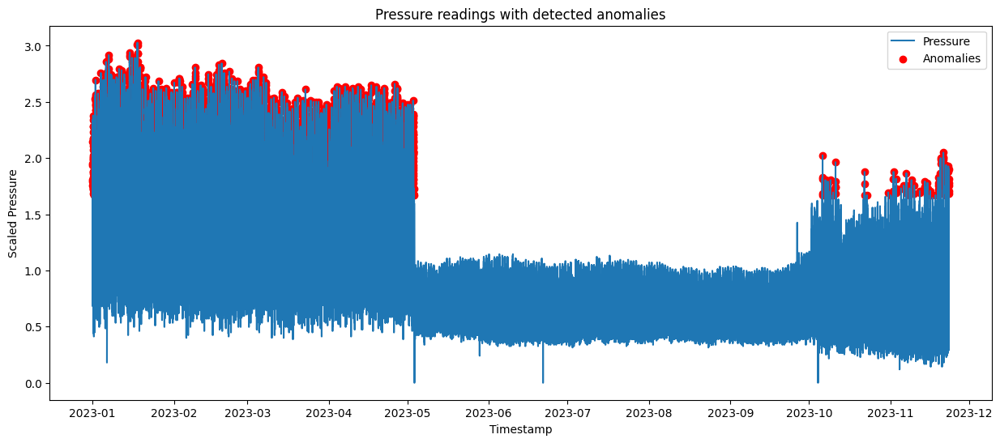

In [163]:
# Scale the entire resampled dataset using the parameters from normal_data
pressure_scaled = scaler.transform(resampled_df[['Pressure']])

# Define the autoencoder network
input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2  # This is the size of our encoded representations

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and fit the autoencoder
autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the entire resampled and scaled dataset
predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)
resampled_df['Reconstruction_Error'] = mse

# Set a threshold for anomaly detection
mse_threshold = np.quantile(resampled_df['Reconstruction_Error'], 0.918) # Adjust the quantile value as needed

# Flag data points as anomalies
resampled_df['Predicted_Anomalies'] = resampled_df['Reconstruction_Error'] > mse_threshold

# Plot reconstruction error over time
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=mse_threshold, color='r', linestyle='--', label='Threshold')
plt.title('Reconstruction error of all data points')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction error')
plt.legend()
plt.show()

# Plot original data with anomalies marked
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [164]:
autoencoder.save('model_reductor6.h5')

c:\Users\mikel\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [165]:
# Define thresholds for severity levels based on percentiles
severity_thresholds = {
    'mild': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.75),
    'moderate': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.90),
    'severe': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.99)
}

# Function to classify anomaly severity
def classify_anomaly_severity(row):
    if row['Predicted_Anomalies']:
        if row['Reconstruction_Error'] <= severity_thresholds['mild']:
            return 'Mild'
        elif row['Reconstruction_Error'] <= severity_thresholds['moderate']:
            return 'Moderate'
        else:
            return 'Severe'
    else:
        return 'Normal'

# Apply the classification function
resampled_df['Anomaly_Severity'] = resampled_df.apply(classify_anomaly_severity, axis=1)



In [166]:
import plotly.graph_objects as go
import nbformat

fig = go.Figure()

# Plot the normal pressure readings
fig.add_trace(go.Scatter(x=resampled_df.index, y=resampled_df['Pressure'], mode='lines', name='Pressure'))

# Separate the anomalies based on severity
mild_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Mild']
moderate_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Moderate']
severe_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Severe']

# Add traces for anomalies with different colors
fig.add_trace(go.Scatter(x=mild_anomalies.index, y=mild_anomalies['Pressure'], mode='markers', name='Mild Anomalies', marker_color='yellow'))
fig.add_trace(go.Scatter(x=moderate_anomalies.index, y=moderate_anomalies['Pressure'], mode='markers', name='Moderate Anomalies', marker_color='orange'))
fig.add_trace(go.Scatter(x=severe_anomalies.index, y=severe_anomalies['Pressure'], mode='markers', name='Severe Anomalies', marker_color='red'))


fig.update_layout(title='Pressure readings with detected anomalies', xaxis_title='Timestamp', yaxis_title='Scaled Pressure')


fig.show()


In [167]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))


precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0


print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 1.0
Recall / Sensitivity: 1.0
F1 Score: 1.0
False Positive Rate: 0.0
True Negative Rate: 1.0
Specificity: 1.0
Matthews Correlation Coefficient: 1.0
Accuracy: 1.0
Error: 0.0
Suma Total de Anomalías: 7535
Suma Total de Anomalías Predecidas: 7535


In [168]:
from sklearn.metrics import f1_score, confusion_matrix
import numpy as np

# True labels
true_labels = df['Anomalies'].values

predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)

quantiles = np.linspace(0.90, 0.999, 100)

# Store the best quantile value and its corresponding F1 score
best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    # Calculate threshold for the current quantile
    threshold = np.quantile(mse, quantile)
    # Predict anomalies using the calculated threshold
    predicted_anomalies = mse > threshold
    # Calculate the F1 score comparing the true labels with the predicted anomalies
    f1 = f1_score(true_labels, predicted_anomalies)
    
    # If the current F1 score is better than the best one so far, update the best score and quantile
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")
print(f"Best F1 score: {best_f1_score}")
print(f"Confusion Matrix at Best Quantile:\n{best_confusion_matrix}")

# Use the best quantile to set the mse_threshold
best_mse_threshold = np.quantile(mse, best_quantile)
print(f"Best MSE Threshold: {best_mse_threshold}")

# Flag data points as anomalies using the best threshold
resampled_df['Predicted_Anomalies'] = mse > best_mse_threshold


   1/2936 [..............................] - ETA: 58s

2936/2936 [==============================] - 2s 680us/step
Best quantile: 0.918
Best F1 score: 1.0
Confusion Matrix at Best Quantile:
[[86411     0]
 [    0  7535]]
Best MSE Threshold: 27.680535847502686


In [169]:
import mysql.connector

df = pd.read_csv('VILLABONA_AMASA_2023.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp']).dt.strftime('%Y-%m-%d %H:%M:%S')  # Format for MySQL

db_config = {
    'host': '127.0.0.1',
    'port': 3306,
    'user': 'admin',
    'password': 'admin@eskola',
    'database': 'aiqua'
}


with mysql.connector.connect(**db_config) as conn:
    with conn.cursor() as cursor:
        # Prepare the insert statement
        query = """
        INSERT INTO data (timestamp, flow, pressure, reductorID)
        VALUES (%s, %s, %s, %s)
        """
        
        values = df.drop(columns=['ID', 'Unknown']).assign(reductorID=6).values.tolist()
        
        batch_size = 500
        for start in range(0, len(values), batch_size):
            end = start + batch_size
            batch_values = values[start:end]
            try:
                cursor.executemany(query, batch_values)
                conn.commit()  # Commit after each batch
            except mysql.connector.Error as err:
                print("Error: {}".format(err))
                conn.rollback()  # Rollback in case of error

# ANOETA HERRIKO ESKOLA

In [170]:
import pandas as pd

df = pd.read_csv('ANOETA_HERRIKO_ESKOLA_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df = df.drop(['ID', 'Flow', 'Unknown'], axis=1)
df.head()

,Timestamp,Pressure
0,2021-01-01 00:05:00,3.393
1,2021-01-01 00:05:00,3.711
2,2021-01-01 00:05:00,3.552
3,2021-01-01 00:10:00,3.430
4,2021-01-01 00:10:00,3.198


In [171]:
numeric_cols = df[['Pressure']]
numeric_cols.set_index(df['Timestamp'], inplace=True)

# Resampling the data to a 5-minute interval using mean
df = numeric_cols.resample('5T').mean()

df['Timestamp'] = df.index

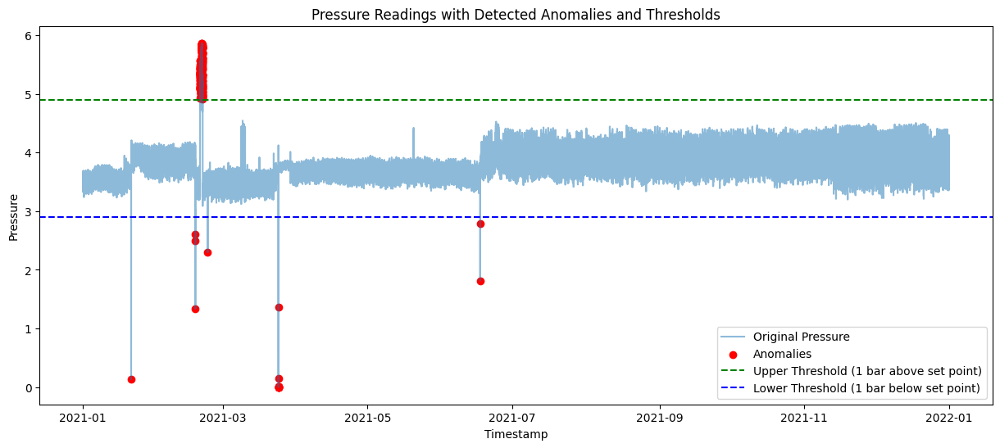

Set Point: 3.90287786746806
Suma Total de Anomalías: 316


In [172]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculating the mean within the correct range as set point
set_point = df.loc['2021-07-01':'2022-01-01', 'Pressure'].mean()

# Defining operational thresholds
upper_threshold = set_point + 1  # 1 bar above the set point
lower_threshold = set_point - 1  # 1 bar below the set point
df = df.dropna()
# Identifying points outside the threshold
df['Anomalies'] = ((df['Pressure'] > upper_threshold) | (df['Pressure'] < lower_threshold))

# Plotting the results with threshold lines
plt.figure(figsize=(15, 6))
plt.plot(df.index, df['Pressure'], label='Original Pressure', alpha=0.5)

# Highlight the anomalies
anomalies = df[df['Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='red', label='Anomalies')

# Add horizontal lines for the upper and lower threshold
plt.axhline(y=upper_threshold, color='green', linestyle='--', label='Upper Threshold (1 bar above set point)')
plt.axhline(y=lower_threshold, color='blue', linestyle='--', label='Lower Threshold (1 bar below set point)')

plt.title('Pressure Readings with Detected Anomalies and Thresholds')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()

# Print the set point for reference
print("Set Point:", set_point)
suma_anomalias = df['Anomalies'].sum()

print(f"Suma Total de Anomalías: {suma_anomalias}")

Epoch 1/50
166/166 [==============================] - 1s 2ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 5/50
166/166 [==============================] - 0s 1000us/step - loss: 0.8917 - val_loss: 1.4332
Epoch 6/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 8/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 9/50
166/166 [==============================] - 0s 980us/step - loss: 0.8917 - val_loss: 1.4332
Epoch 10/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\4043642363.py:81: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\4043642363.py:82: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



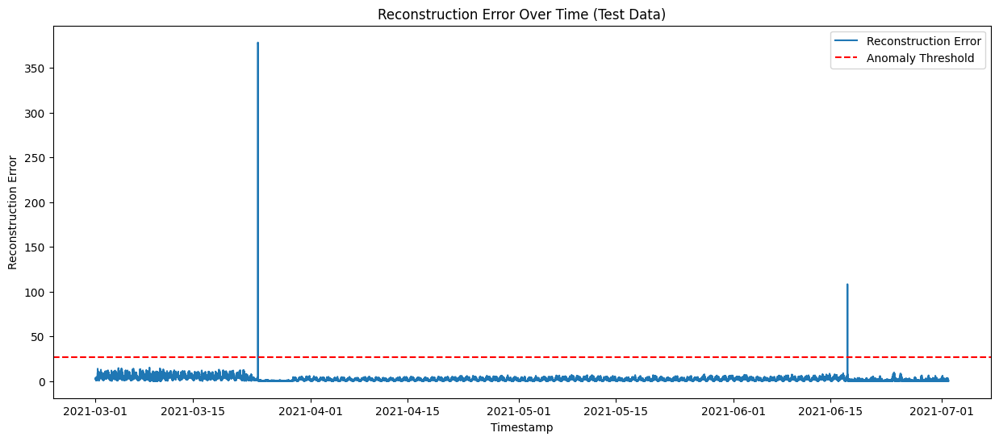

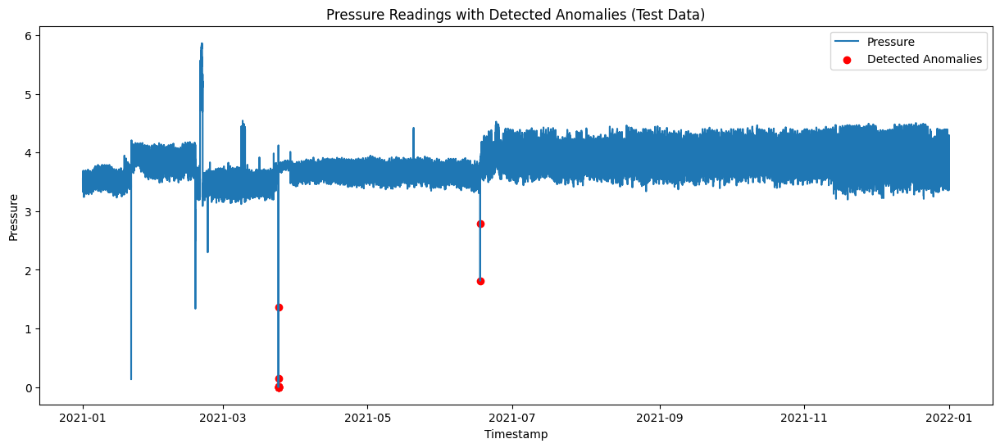

In [173]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2021-07-01':'2022-01-01']
val_data = resampled_df['2021-01-01':'2021-03-1']
test_data = resampled_df['2021-03-01':'2021-07-01']

scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])


val_pressure_scaled = scaler.transform(val_data[['Pressure']])
test_pressure_scaled = scaler.transform(test_data[['Pressure']])


input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2 

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the validation set and calculate MSE
val_predictions = autoencoder.predict(val_pressure_scaled)
val_mse = np.mean(np.power(val_pressure_scaled - val_predictions, 2), axis=1)

# Extract true labels for the same range as val_data
true_labels = df.loc[val_data.index, 'Anomalies'].values

# Define a range of potential quantiles to search
quantiles = np.linspace(0.85, 0.999, 100)

best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    threshold = np.quantile(val_mse, quantile)
    predicted_anomalies = val_mse > threshold

    # Calculate the F1 score
    f1 = f1_score(true_labels, predicted_anomalies)
    
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")

# Use the best quantile to set the mse_threshold on the test set
best_mse_threshold = np.quantile(val_mse, best_quantile)

# Predict on the test set
test_predictions = autoencoder.predict(test_pressure_scaled)
test_mse = np.mean(np.power(test_pressure_scaled - test_predictions, 2), axis=1)
test_data['Reconstruction_Error'] = test_mse
test_data['Predicted_Anomalies'] = test_mse > best_mse_threshold

plt.figure(figsize=(15, 6))
plt.plot(test_data.index, test_data['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=best_mse_threshold, color='r', linestyle='--', label='Anomaly Threshold')
plt.title('Reconstruction Error Over Time (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction Error')
plt.legend()
plt.show()

plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = test_data[test_data['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Detected Anomalies')
plt.title('Pressure Readings with Detected Anomalies (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()



In [174]:
import pandas as pd
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score, matthews_corrcoef

test_true_labels = df.loc[test_data.index, 'Anomalies']

if test_true_labels.shape[0] != test_data.shape[0]:
    raise ValueError("Mismatch in the number of rows between test data and true labels.")

# Ensure binary format and handle NaN values
test_true_labels = test_true_labels.fillna(0).astype(int)
test_data['Predicted_Anomalies'] = test_data['Predicted_Anomalies'].fillna(0).astype(int)

TN, FP, FN, TP = confusion_matrix(test_true_labels, test_data['Predicted_Anomalies']).ravel()

precision = precision_score(test_true_labels, test_data['Predicted_Anomalies'])
recall = recall_score(test_true_labels, test_data['Predicted_Anomalies'])
f1 = f1_score(test_true_labels, test_data['Predicted_Anomalies'])
accuracy = accuracy_score(test_true_labels, test_data['Predicted_Anomalies'])
mcc = matthews_corrcoef(test_true_labels, test_data['Predicted_Anomalies'])
error_rate = (FP + FN) / (TP + FP + FN + TN)

print("Confusion Matrix:")
print(f"True Positives (TP): {TP}")
print(f"False Positives (FP): {FP}")
print(f"True Negatives (TN): {TN}")
print(f"False Negatives (FN): {FN}")
print("\nMetrics:")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")
print(f"Accuracy: {accuracy:.2f}")
print(f"Matthews Correlation Coefficient (MCC): {mcc:.2f}")
print(f"Error Rate: {error_rate:.2f}")

sum_true_anomalies = test_true_labels.sum()
sum_predicted_anomalies = test_data['Predicted_Anomalies'].sum()

print(f"Sum of True Anomalies in Test Range: {sum_true_anomalies}")
print(f"Sum of Predicted Anomalies in Test Range: {sum_predicted_anomalies}")


Confusion Matrix:
True Positives (TP): 11
False Positives (FP): 0
True Negatives (TN): 35401
False Negatives (FN): 0

Metrics:
Precision: 1.00
Recall: 1.00
F1 Score: 1.00
Accuracy: 1.00
Matthews Correlation Coefficient (MCC): 1.00
Error Rate: 0.00
Sum of True Anomalies in Test Range: 11
Sum of Predicted Anomalies in Test Range: 11


C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\2972097268.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [175]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt


resampled_df = df.resample('5T').mean()
# Drop rows with NaN values in resampled_df
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2021-07-01':'2022-01-01']

# Scale the 'Pressure' values of normal_data
scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])

joblib.dump(scaler, 'scaler_reductor5.save')

['scaler_reductor5.save']

Epoch 1/50
166/166 [==============================] - 1s 2ms/step - loss: 0.8918 - val_loss: 1.4333
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8918 - val_loss: 1.4332
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 6/50
166/166 [==============================] - 0s 999us/step - loss: 0.8917 - val_loss: 1.4332
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 8/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 9/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.4332
Epoch 10/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8917 - val_loss: 1.43

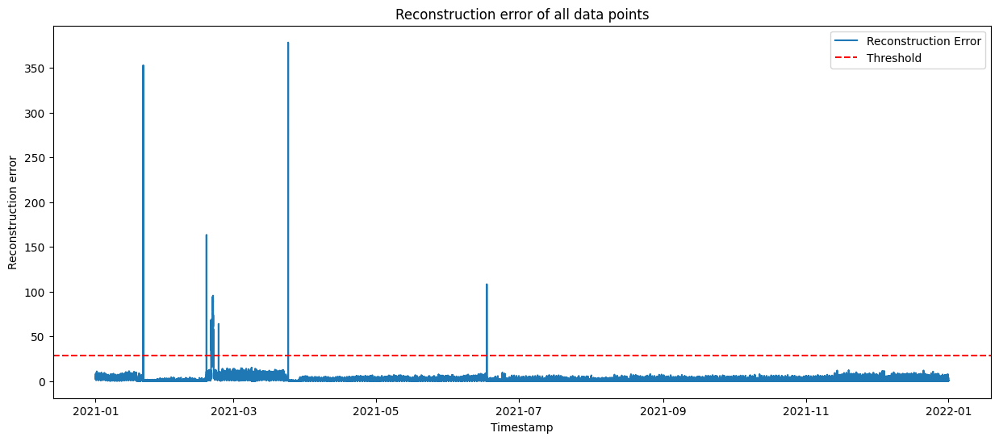

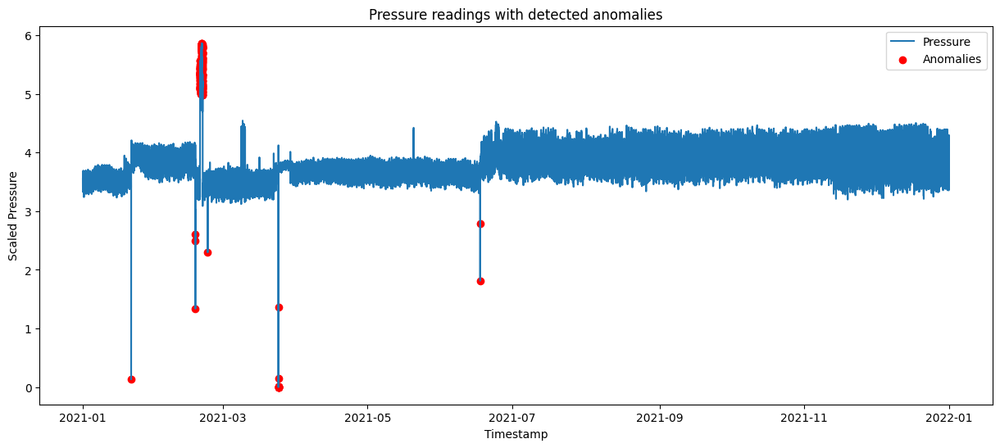

In [176]:
# Scale the entire resampled dataset using the parameters from normal_data
pressure_scaled = scaler.transform(resampled_df[['Pressure']])

# Define the autoencoder network
input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2  # This is the size of our encoded representations

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and fit the autoencoder
autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the entire resampled and scaled dataset
predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)
resampled_df['Reconstruction_Error'] = mse

# Set a threshold for anomaly detection
mse_threshold = np.quantile(resampled_df['Reconstruction_Error'], 0.9971) # Adjust the quantile value as needed

# Flag data points as anomalies
resampled_df['Predicted_Anomalies'] = resampled_df['Reconstruction_Error'] > mse_threshold

# Plot reconstruction error over time
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=mse_threshold, color='r', linestyle='--', label='Threshold')
plt.title('Reconstruction error of all data points')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction error')
plt.legend()
plt.show()

# Plot original data with anomalies marked
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [177]:
autoencoder.save('model_reductor5.h5')

c:\Users\mikel\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [178]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))

precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 1.0
Recall / Sensitivity: 0.9651898734177216
F1 Score: 0.9822866344605475
False Positive Rate: 0.0
True Negative Rate: 1.0
Specificity: 1.0
Matthews Correlation Coefficient: 0.982389097853761
Accuracy: 0.9998951102296132
Error: 0.00010488977038675719
Suma Total de Anomalías: 316
Suma Total de Anomalías Predecidas: 305


In [179]:
from sklearn.metrics import f1_score, confusion_matrix
import numpy as np

# True labels
true_labels = df['Anomalies'].values

predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)

# Define a range of potential quantiles to search
quantiles = np.linspace(0.90, 0.999, 100)

# Store the best quantile value and its corresponding F1 score
best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    # Calculate threshold for the current quantile
    threshold = np.quantile(mse, quantile)
    # Predict anomalies using the calculated threshold
    predicted_anomalies = mse > threshold
    # Calculate the F1 score comparing the true labels with the predicted anomalies
    f1 = f1_score(true_labels, predicted_anomalies)
    
    # If the current F1 score is better than the best one so far, update the best score and quantile
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")
print(f"Best F1 score: {best_f1_score}")
print(f"Confusion Matrix at Best Quantile:\n{best_confusion_matrix}")

# Use the best quantile to set the mse_threshold
best_mse_threshold = np.quantile(mse, best_quantile)
print(f"Best MSE Threshold: {best_mse_threshold}")

# Flag data points as anomalies using the best threshold
resampled_df['Predicted_Anomalies'] = mse > best_mse_threshold


3278/3278 [==============================] - 2s 634us/step
Best quantile: 0.997
Best F1 score: 0.9984152139461173
Confusion Matrix at Best Quantile:
[[104556      0]
 [     1    315]]
Best MSE Threshold: 25.40776313204773


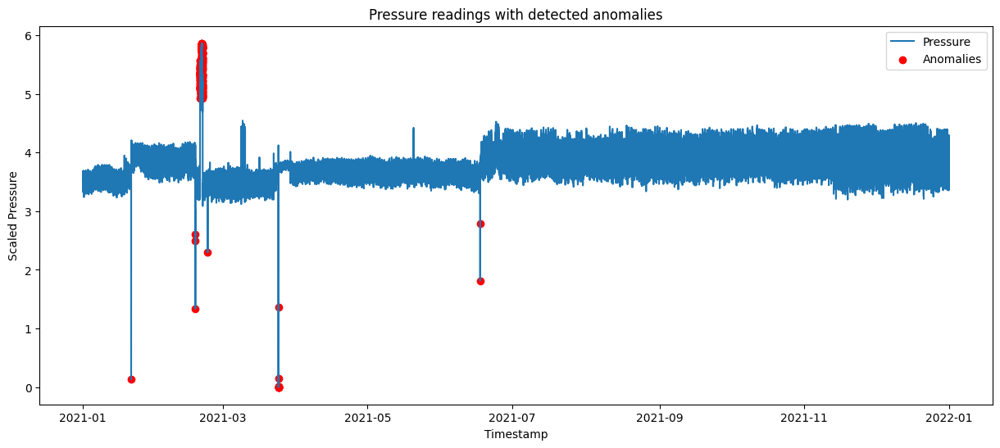

In [180]:
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [181]:
# Define thresholds for severity levels based on percentiles
severity_thresholds = {
    'mild': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.75),
    'moderate': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.90),
    'severe': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.99)
}

# Function to classify anomaly severity
def classify_anomaly_severity(row):
    if row['Predicted_Anomalies']:
        if row['Reconstruction_Error'] <= severity_thresholds['mild']:
            return 'Mild'
        elif row['Reconstruction_Error'] <= severity_thresholds['moderate']:
            return 'Moderate'
        else:
            return 'Severe'
    else:
        return 'Normal'

# Apply the classification function
resampled_df['Anomaly_Severity'] = resampled_df.apply(classify_anomaly_severity, axis=1)



In [182]:
import plotly.graph_objects as go
import nbformat

fig = go.Figure()

# Plot the normal pressure readings
fig.add_trace(go.Scatter(x=resampled_df.index, y=resampled_df['Pressure'], mode='lines', name='Pressure'))

# Separate the anomalies based on severity
mild_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Mild']
moderate_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Moderate']
severe_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Severe']

# Add traces for anomalies with different colors
fig.add_trace(go.Scatter(x=mild_anomalies.index, y=mild_anomalies['Pressure'], mode='markers', name='Mild Anomalies', marker_color='yellow'))
fig.add_trace(go.Scatter(x=moderate_anomalies.index, y=moderate_anomalies['Pressure'], mode='markers', name='Moderate Anomalies', marker_color='orange'))
fig.add_trace(go.Scatter(x=severe_anomalies.index, y=severe_anomalies['Pressure'], mode='markers', name='Severe Anomalies', marker_color='red'))

# Add title and labels
fig.update_layout(title='Pressure readings with detected anomalies', xaxis_title='Timestamp', yaxis_title='Scaled Pressure')

fig.show()


In [183]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))

precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 1.0
Recall / Sensitivity: 0.9968354430379747
F1 Score: 0.9984152139461173
False Positive Rate: 0.0
True Negative Rate: 1.0
Specificity: 1.0
Matthews Correlation Coefficient: 0.9984116932123402
Accuracy: 0.9999904645663285
Error: 9.535433671523381e-06
Suma Total de Anomalías: 316
Suma Total de Anomalías Predecidas: 315


Here we can see that the model predicted anomalies became more accurate with the quantile tuning

In [184]:
import mysql.connector

df = pd.read_csv('ANOETA_HERRIKO_ESKOLA_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp']).dt.strftime('%Y-%m-%d %H:%M:%S')  # Format for MySQL

db_config = {
    'host': '127.0.0.1',
    'port': 3306,
    'user': 'admin',
    'password': 'admin@eskola',
    'database': 'aiqua'
}

with mysql.connector.connect(**db_config) as conn:
    with conn.cursor() as cursor:
        # Prepare the insert statement
        query = """
        INSERT INTO data (timestamp, flow, pressure, reductorID)
        VALUES (%s, %s, %s, %s)
        """
        
        # Prepare the data for insertion
        values = df.drop(columns=['ID', 'Unknown']).assign(reductorID=5).values.tolist()
        
        # Define a smaller batch size if necessary
        batch_size = 500
        for start in range(0, len(values), batch_size):
            end = start + batch_size
            batch_values = values[start:end]
            try:
                cursor.executemany(query, batch_values)
                conn.commit()  # Commit after each batch
            except mysql.connector.Error as err:
                print("Error: {}".format(err))
                conn.rollback()  # Rollback in case of error

# TOLOSA BERAZUBI

In [185]:
import pandas as pd

df = pd.read_csv('TOLOSA_BERAZUBI_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df = df.drop(['ID', 'Flow', 'Unknown'], axis=1)
df.head()

,Timestamp,Pressure
0,2020-10-01 16:41:13.190,3.980
1,2020-10-01 16:41:13.280,4.016
2,2020-10-01 16:41:13.290,3.955
3,2020-10-01 16:41:13.340,3.992
4,2020-10-01 16:41:13.410,3.943


In [186]:
numeric_cols = df[['Pressure']]
numeric_cols.set_index(df['Timestamp'], inplace=True)

# Resampling the data to a 5-minute interval using mean
df = numeric_cols.resample('5T').mean()

df['Timestamp'] = df.index



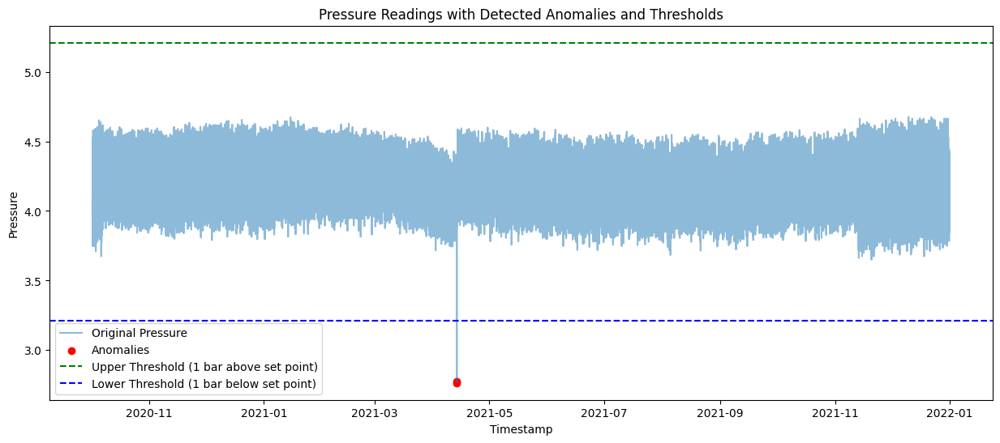

Set Point: 4.209075144197659
Suma Total de Anomalías: 2


In [187]:
import pandas as pd
import matplotlib.pyplot as plt


# Calculating the mean within the correct range as set point
set_point = df.loc['2020-11-01':'2021-03-01', 'Pressure'].mean()

# Defining operational thresholds
upper_threshold = set_point + 1  # 1 bar above the set point
lower_threshold = set_point - 1  # 1 bar below the set point
df = df.dropna()
# Identifying points outside the threshold
df['Anomalies'] = ((df['Pressure'] > upper_threshold) | (df['Pressure'] < lower_threshold))

# Plotting the results with threshold lines
plt.figure(figsize=(15, 6))
plt.plot(df.index, df['Pressure'], label='Original Pressure', alpha=0.5)

# Highlight the anomalies
anomalies = df[df['Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='red', label='Anomalies')

# Add horizontal lines for the upper and lower threshold
plt.axhline(y=upper_threshold, color='green', linestyle='--', label='Upper Threshold (1 bar above set point)')
plt.axhline(y=lower_threshold, color='blue', linestyle='--', label='Lower Threshold (1 bar below set point)')

plt.title('Pressure Readings with Detected Anomalies and Thresholds')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()

# Print the set point for reference
print("Set Point:", set_point)
suma_anomalias = df['Anomalies'].sum()

print(f"Suma Total de Anomalías: {suma_anomalias}")

Epoch 1/50
109/109 [==============================] - 1s 2ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 2/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 3/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 4/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8520
Epoch 5/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8520
Epoch 6/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8520
Epoch 7/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8520
Epoch 8/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0370 - val_loss: 0.8520
Epoch 9/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0370 - val_loss: 0.8520
Epoch 10/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0370 - val_loss: 0.8520

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\362229549.py:81: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\362229549.py:82: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



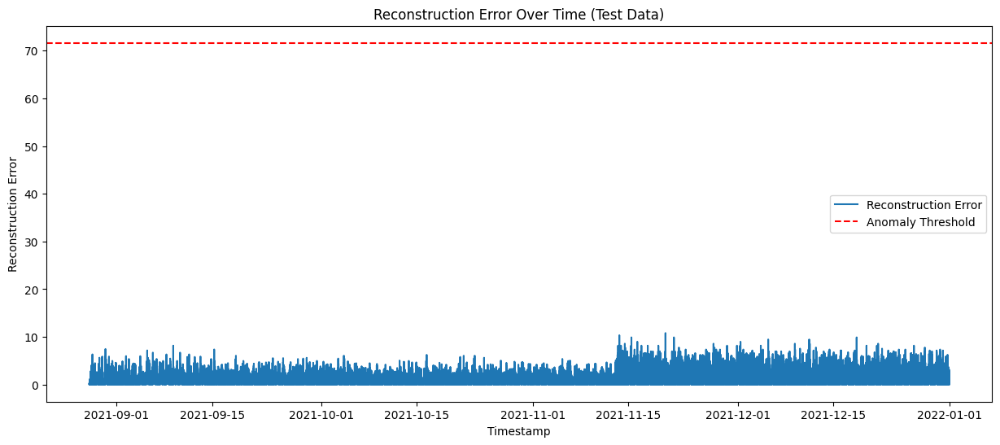

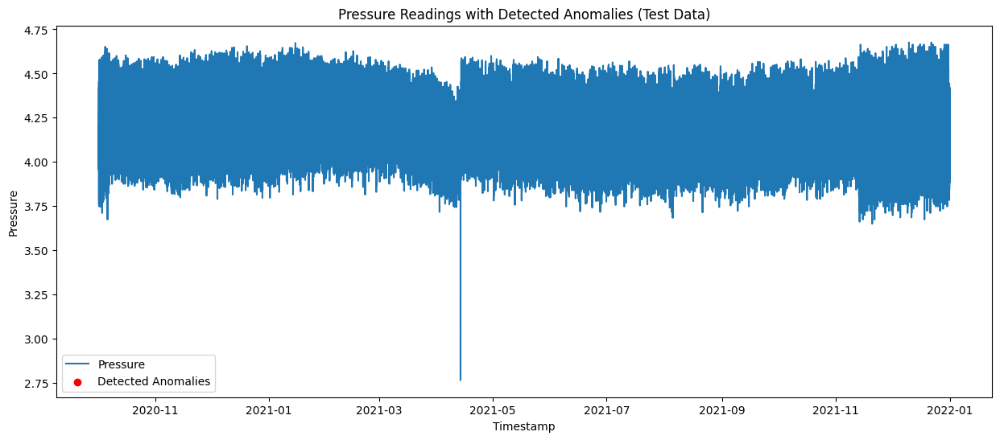

In [188]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2020-11-01':'2021-03-01']
val_data = resampled_df['2021-03-01':'2021-08-28']
test_data = resampled_df['2021-08-28':'2022-01-01']

scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])


val_pressure_scaled = scaler.transform(val_data[['Pressure']])
test_pressure_scaled = scaler.transform(test_data[['Pressure']])


input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2 

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the validation set and calculate MSE
val_predictions = autoencoder.predict(val_pressure_scaled)
val_mse = np.mean(np.power(val_pressure_scaled - val_predictions, 2), axis=1)

# Extract true labels for the same range as val_data
true_labels = df.loc[val_data.index, 'Anomalies'].values

# Define a range of potential quantiles to search
quantiles = np.linspace(0.80, 0.99999, 100)

best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    threshold = np.quantile(val_mse, quantile)
    predicted_anomalies = val_mse > threshold

    # Calculate the F1 score
    f1 = f1_score(true_labels, predicted_anomalies)
    
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")

# Use the best quantile to set the mse_threshold on the test set
best_mse_threshold = np.quantile(val_mse, best_quantile)

# Predict on the test set
test_predictions = autoencoder.predict(test_pressure_scaled)
test_mse = np.mean(np.power(test_pressure_scaled - test_predictions, 2), axis=1)
test_data['Reconstruction_Error'] = test_mse
test_data['Predicted_Anomalies'] = test_mse > best_mse_threshold

plt.figure(figsize=(15, 6))
plt.plot(test_data.index, test_data['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=best_mse_threshold, color='r', linestyle='--', label='Anomaly Threshold')
plt.title('Reconstruction Error Over Time (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction Error')
plt.legend()
plt.show()

plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = test_data[test_data['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Detected Anomalies')
plt.title('Pressure Readings with Detected Anomalies (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()



No anomalies to do metrics

In [189]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt


resampled_df = df.resample('5T').mean()
# Drop rows with NaN values in resampled_df
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2020-11-01':'2021-03-01']

# Scale the 'Pressure' values of normal_data
scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])

joblib.dump(scaler, 'scaler_reductor1.save')

['scaler_reductor1.save']

Epoch 1/50
109/109 [==============================] - 1s 2ms/step - loss: 1.0375 - val_loss: 0.8521
Epoch 2/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 3/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 4/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 5/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 6/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 7/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 8/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 9/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8521
Epoch 10/50
109/109 [==============================] - 0s 1ms/step - loss: 1.0371 - val_loss: 0.8520

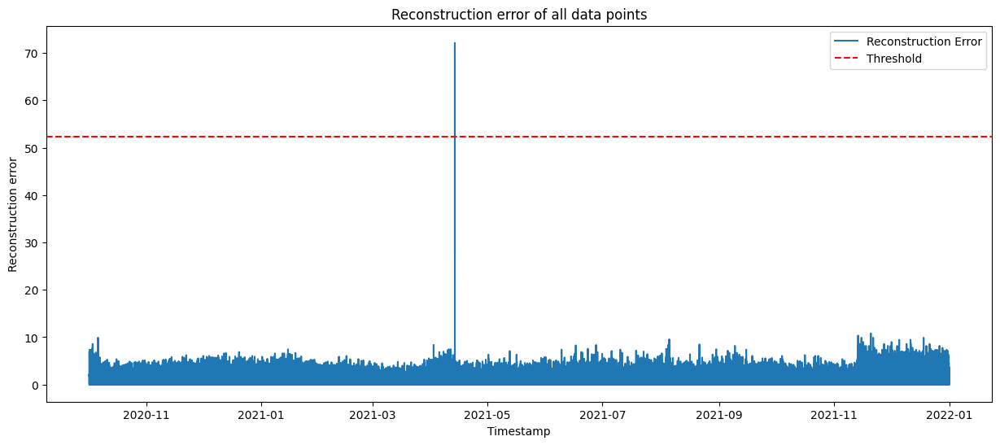

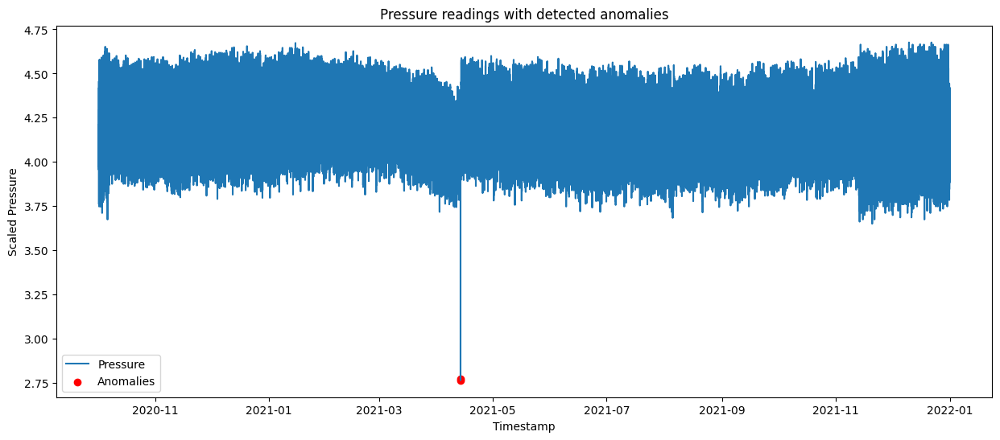

In [190]:
# Scale the entire resampled dataset using the parameters from normal_data
pressure_scaled = scaler.transform(resampled_df[['Pressure']])

# Define the autoencoder network
input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2  # This is the size of our encoded representations

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and fit the autoencoder
autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the entire resampled and scaled dataset
predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)
resampled_df['Reconstruction_Error'] = mse

# Set a threshold for anomaly detection
mse_threshold = np.quantile(resampled_df['Reconstruction_Error'], 0.99999) # Adjust the quantile value as needed

# Flag data points as anomalies
resampled_df['Predicted_Anomalies'] = resampled_df['Reconstruction_Error'] > mse_threshold

# Plot reconstruction error over time
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=mse_threshold, color='r', linestyle='--', label='Threshold')
plt.title('Reconstruction error of all data points')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction error')
plt.legend()
plt.show()

# Plot original data with anomalies marked
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [191]:
autoencoder.save('model_reductor1.h5')

c:\Users\mikel\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [192]:
from sklearn.metrics import f1_score, confusion_matrix
import numpy as np

# True labels
true_labels = df['Anomalies'].values

predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)

# Define a range of potential quantiles to search
quantiles = np.linspace(0.90, 0.99999, 100)

# Store the best quantile value and its corresponding F1 score
best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    # Calculate threshold for the current quantile
    threshold = np.quantile(mse, quantile)
    # Predict anomalies using the calculated threshold
    predicted_anomalies = mse > threshold
    # Calculate the F1 score comparing the true labels with the predicted anomalies
    f1 = f1_score(true_labels, predicted_anomalies)
    
    # If the current F1 score is better than the best one so far, update the best score and quantile
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")
print(f"Best F1 score: {best_f1_score}")
print(f"Confusion Matrix at Best Quantile:\n{best_confusion_matrix}")

# Use the best quantile to set the mse_threshold
best_mse_threshold = np.quantile(mse, best_quantile)
print(f"Best MSE Threshold: {best_mse_threshold}")

# Flag data points as anomalies using the best threshold
resampled_df['Predicted_Anomalies'] = mse > best_mse_threshold


4103/4103 [==============================] - 3s 614us/step
Best quantile: 0.99999
Best F1 score: 1.0
Confusion Matrix at Best Quantile:
[[131283      0]
 [     0      2]]
Best MSE Threshold: 52.31404849090272


In [193]:
# Define thresholds for severity levels based on percentiles
severity_thresholds = {
    'mild': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.75),
    'moderate': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.90),
    'severe': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.99)
}

# Function to classify anomaly severity
def classify_anomaly_severity(row):
    if row['Predicted_Anomalies']:
        if row['Reconstruction_Error'] <= severity_thresholds['mild']:
            return 'Mild'
        elif row['Reconstruction_Error'] <= severity_thresholds['moderate']:
            return 'Moderate'
        else:
            return 'Severe'
    else:
        return 'Normal'

# Apply the classification function
resampled_df['Anomaly_Severity'] = resampled_df.apply(classify_anomaly_severity, axis=1)



In [194]:
import plotly.graph_objects as go
import nbformat

fig = go.Figure()

# Plot the normal pressure readings
fig.add_trace(go.Scatter(x=resampled_df.index, y=resampled_df['Pressure'], mode='lines', name='Pressure'))

# Separate the anomalies based on severity
mild_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Mild']
moderate_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Moderate']
severe_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Severe']

# Add traces for anomalies with different colors
fig.add_trace(go.Scatter(x=mild_anomalies.index, y=mild_anomalies['Pressure'], mode='markers', name='Mild Anomalies', marker_color='yellow'))
fig.add_trace(go.Scatter(x=moderate_anomalies.index, y=moderate_anomalies['Pressure'], mode='markers', name='Moderate Anomalies', marker_color='orange'))
fig.add_trace(go.Scatter(x=severe_anomalies.index, y=severe_anomalies['Pressure'], mode='markers', name='Severe Anomalies', marker_color='red'))

# Add title and labels
fig.update_layout(title='Pressure readings with detected anomalies', xaxis_title='Timestamp', yaxis_title='Scaled Pressure')


fig.show()


In [195]:
import mysql.connector

df = pd.read_csv('TOLOSA_BERAZUBI_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp']).dt.strftime('%Y-%m-%d %H:%M:%S')  # Format for MySQL

db_config = {
    'host': '127.0.0.1',
    'port': 3306,
    'user': 'admin',
    'password': 'admin@eskola',
    'database': 'aiqua'
}

with mysql.connector.connect(**db_config) as conn:
    with conn.cursor() as cursor:
        # Prepare the insert statement
        query = """
        INSERT INTO data (timestamp, flow, pressure, reductorID)
        VALUES (%s, %s, %s, %s)
        """
        
        # Prepare the data for insertion
        values = df.drop(columns=['ID', 'Unknown']).assign(reductorID=1).values.tolist()
        
        # Define a smaller batch size if necessary
        batch_size = 500
        for start in range(0, len(values), batch_size):
            end = start + batch_size
            batch_values = values[start:end]
            try:
                cursor.executemany(query, batch_values)
                conn.commit()  # Commit after each batch
            except mysql.connector.Error as err:
                print("Error: {}".format(err))
                conn.rollback()  # Rollback in case of error

## TOLOSA KONDE

In [196]:
import pandas as pd

df = pd.read_csv('TOLOSA_KONDEKO_ALDAPA_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df = df.drop(['ID', 'Flow', 'Unknown'], axis=1)
df.head()

,Timestamp,Pressure
0,2020-11-16 10:09:48.000,0.000
1,2020-11-16 10:09:48.000,4.908
2,2020-11-16 10:09:48.000,4.041
3,2020-11-16 10:09:51.330,4.933
4,2020-11-16 10:09:51.430,4.933


In [197]:
# Setting the timestamp as the index
df.set_index('Timestamp', inplace=True)

# Resampling the data to a 5-minute interval using mean
df = df.resample('5T').mean()

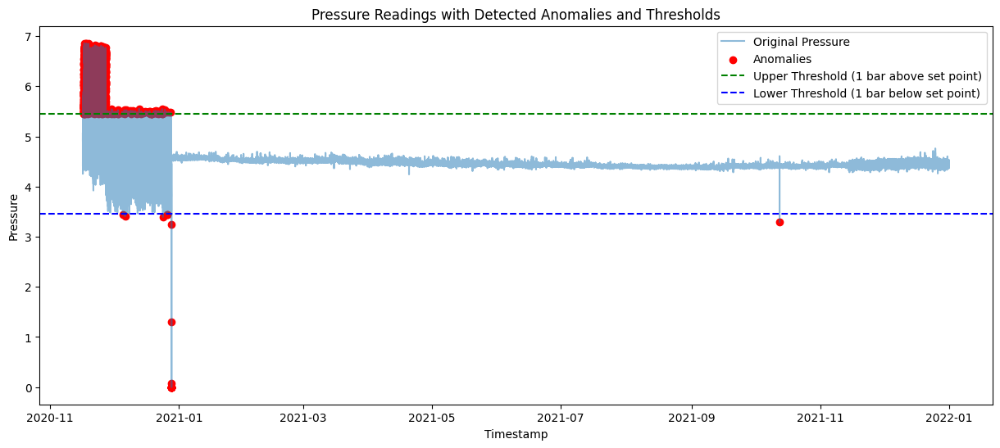

Set Point: 4.451303131297665
Suma Total de Anomalías: 1488


In [198]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculating the mean within the correct range as set point
set_point = df.loc['2021-01-01':'2022-09-01', 'Pressure'].mean()

# Defining operational thresholds
upper_threshold = set_point + 1  # 1 bar above the set point
lower_threshold = set_point - 1  # 1 bar below the set point
df = df.dropna()
# Identifying points outside the threshold
df['Anomalies'] = ((df['Pressure'] > upper_threshold) | (df['Pressure'] < lower_threshold))

# Plotting the results with threshold lines
plt.figure(figsize=(15, 6))
plt.plot(df.index, df['Pressure'], label='Original Pressure', alpha=0.5)

# Highlight the anomalies
anomalies = df[df['Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='red', label='Anomalies')

# Add horizontal lines for the upper and lower threshold
plt.axhline(y=upper_threshold, color='green', linestyle='--', label='Upper Threshold (1 bar above set point)')
plt.axhline(y=lower_threshold, color='blue', linestyle='--', label='Lower Threshold (1 bar below set point)')

plt.title('Pressure Readings with Detected Anomalies and Thresholds')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()

# Print the set point for reference
print("Set Point:", set_point)
suma_anomalias = df['Anomalies'].sum()

print(f"Suma Total de Anomalías: {suma_anomalias}")

In [199]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
# Drop rows with NaN values in resampled_df
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2021-01-01':'2022-09-01']

# Scale the 'Pressure' values of normal_data
scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])

joblib.dump(scaler, 'scaler_reductor2.save')

['scaler_reductor2.save']

Epoch 1/50
329/329 [==============================] - 1s 1ms/step - loss: 1.0814 - val_loss: 0.6748
Epoch 2/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0814 - val_loss: 0.6748
Epoch 3/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0814 - val_loss: 0.6747
Epoch 4/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747
Epoch 5/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747
Epoch 6/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747
Epoch 7/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747
Epoch 8/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747
Epoch 9/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747
Epoch 10/50
329/329 [==============================] - 0s 1ms/step - loss: 1.0813 - val_loss: 0.6747

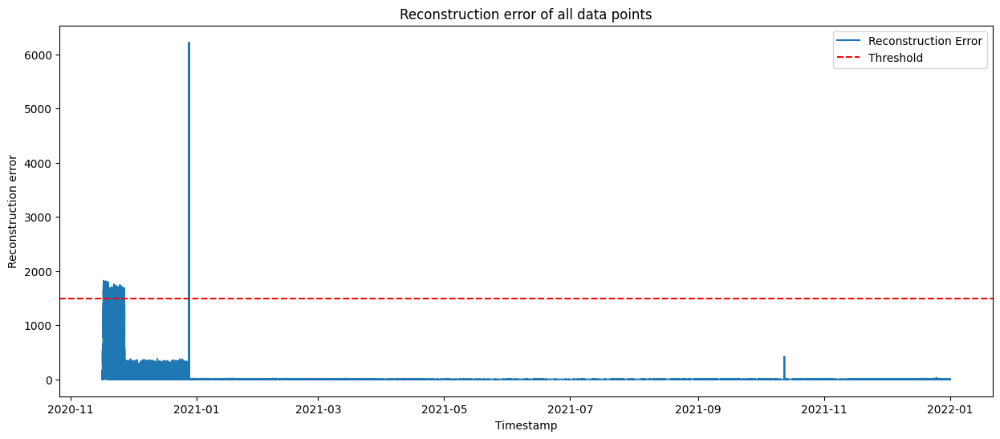

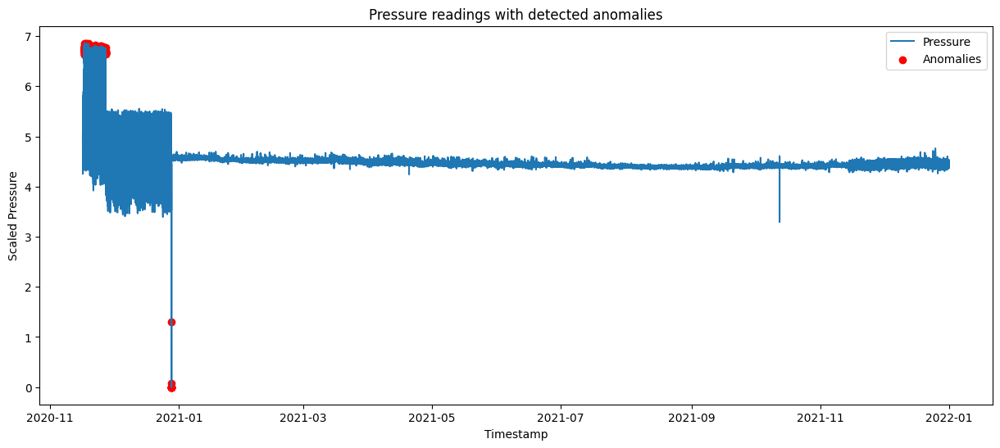

In [200]:
# Scale the entire resampled dataset using the parameters from normal_data
pressure_scaled = scaler.transform(resampled_df[['Pressure']])


# Define the autoencoder network
input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2  # This is the size of our encoded representations

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and fit the autoencoder
autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the entire resampled and scaled dataset
predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)
resampled_df['Reconstruction_Error'] = mse

# Set a threshold for anomaly detection
mse_threshold = np.quantile(resampled_df['Reconstruction_Error'], 0.9971) # Adjust the quantile value as needed

# Flag data points as anomalies
resampled_df['Predicted_Anomalies'] = resampled_df['Reconstruction_Error'] > mse_threshold

# Plot reconstruction error over time
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=mse_threshold, color='r', linestyle='--', label='Threshold')
plt.title('Reconstruction error of all data points')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction error')
plt.legend()
plt.show()

# Plot original data with anomalies marked
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [201]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))

precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 1.0
Recall / Sensitivity: 0.22849462365591397
F1 Score: 0.37199124726477023
False Positive Rate: 0.0
True Negative Rate: 1.0
Specificity: 1.0
Matthews Correlation Coefficient: 0.47567800859247344
Accuracy: 0.9902901124925991
Error: 0.009709887507400828
Suma Total de Anomalías: 1488
Suma Total de Anomalías Predecidas: 340


In [202]:
autoencoder.save('model_reductor2.h5')

c:\Users\mikel\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [203]:
from sklearn.metrics import f1_score, confusion_matrix
import numpy as np

# True labels
true_labels = df['Anomalies'].values

predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)

# Define a range of potential quantiles to search
quantiles = np.linspace(0.90, 0.999, 100)

# Store the best quantile value and its corresponding F1 score
best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    # Calculate threshold for the current quantile
    threshold = np.quantile(mse, quantile)
    # Predict anomalies using the calculated threshold
    predicted_anomalies = mse > threshold
    # Calculate the F1 score comparing the true labels with the predicted anomalies
    f1 = f1_score(true_labels, predicted_anomalies)
    
    # If the current F1 score is better than the best one so far, update the best score and quantile
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

# Output the results
print(f"Best quantile: {best_quantile}")
print(f"Best F1 score: {best_f1_score}")
print(f"Confusion Matrix at Best Quantile:\n{best_confusion_matrix}")

# Use the best quantile to set the mse_threshold
best_mse_threshold = np.quantile(mse, best_quantile)
print(f"Best MSE Threshold: {best_mse_threshold}")

# Flag data points as anomalies using the best threshold
resampled_df['Predicted_Anomalies'] = mse > best_mse_threshold


3695/3695 [==============================] - 2s 634us/step
Best quantile: 0.987
Best F1 score: 0.9838016528925619
Confusion Matrix at Best Quantile:
[[116693     49]
 [     0   1488]]
Best MSE Threshold: 306.39971642057554


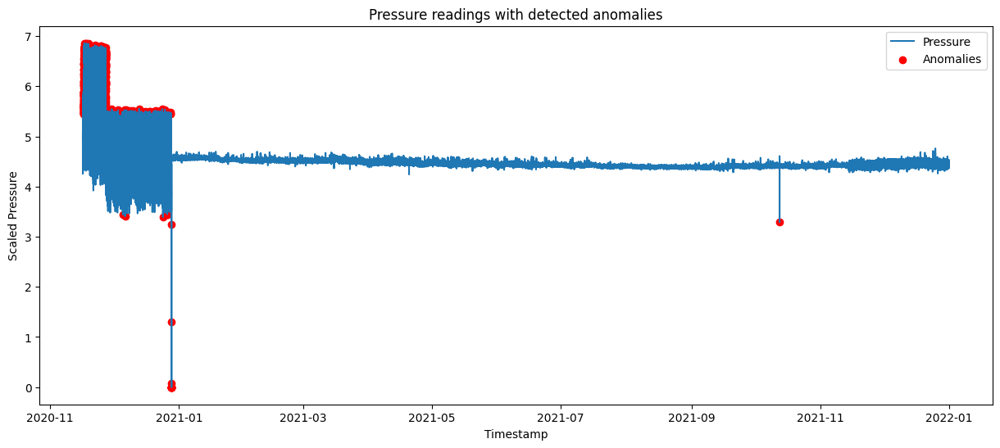

In [204]:
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [205]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))

precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 0.9681197137280416
Recall / Sensitivity: 1.0
F1 Score: 0.9838016528925619
False Positive Rate: 0.00041972897500471126
True Negative Rate: 0.9995802710249952
Specificity: 0.9995802710249952
Matthews Correlation Coefficient: 0.9837242326144644
Accuracy: 0.9995855535820012
Error: 0.00041444641799881585
Suma Total de Anomalías: 1488
Suma Total de Anomalías Predecidas: 1537


We can see the improvement

In [206]:
# Define thresholds for severity levels based on percentiles
severity_thresholds = {
    'mild': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.75),
    'moderate': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.90),
    'severe': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.99)
}

# Function to classify anomaly severity
def classify_anomaly_severity(row):
    if row['Predicted_Anomalies']:
        if row['Reconstruction_Error'] <= severity_thresholds['mild']:
            return 'Mild'
        elif row['Reconstruction_Error'] <= severity_thresholds['moderate']:
            return 'Moderate'
        else:
            return 'Severe'
    else:
        return 'Normal'

# Apply the classification function
resampled_df['Anomaly_Severity'] = resampled_df.apply(classify_anomaly_severity, axis=1)



In [207]:
import plotly.graph_objects as go
import nbformat

fig = go.Figure()

# Plot the normal pressure readings
fig.add_trace(go.Scatter(x=resampled_df.index, y=resampled_df['Pressure'], mode='lines', name='Pressure'))

# Separate the anomalies based on severity
mild_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Mild']
moderate_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Moderate']
severe_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Severe']

# Add traces for anomalies with different colors
fig.add_trace(go.Scatter(x=mild_anomalies.index, y=mild_anomalies['Pressure'], mode='markers', name='Mild Anomalies', marker_color='yellow'))
fig.add_trace(go.Scatter(x=moderate_anomalies.index, y=moderate_anomalies['Pressure'], mode='markers', name='Moderate Anomalies', marker_color='orange'))
fig.add_trace(go.Scatter(x=severe_anomalies.index, y=severe_anomalies['Pressure'], mode='markers', name='Severe Anomalies', marker_color='red'))

# Add title and labels
fig.update_layout(title='Pressure readings with detected anomalies', xaxis_title='Timestamp', yaxis_title='Scaled Pressure')

fig.show()


In [208]:
import mysql.connector

df = pd.read_csv('TOLOSA_KONDEKO_ALDAPA_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp']).dt.strftime('%Y-%m-%d %H:%M:%S')  # Format for MySQL

db_config = {
    'host': '127.0.0.1',
    'port': 3306,
    'user': 'admin',
    'password': 'admin@eskola',
    'database': 'aiqua'
}

with mysql.connector.connect(**db_config) as conn:
    with conn.cursor() as cursor:
        # Prepare the insert statement
        query = """
        INSERT INTO data (timestamp, flow, pressure, reductorID)
        VALUES (%s, %s, %s, %s)
        """
        
        # Prepare the data for insertion
        values = df.drop(columns=['ID', 'Unknown']).assign(reductorID=2).values.tolist()
        
        # Define a smaller batch size if necessary
        batch_size = 500
        for start in range(0, len(values), batch_size):
            end = start + batch_size
            batch_values = values[start:end]
            try:
                cursor.executemany(query, batch_values)
                conn.commit()  # Commit after each batch
            except mysql.connector.Error as err:
                print("Error: {}".format(err))
                conn.rollback()  # Rollback in case of error

## ASTEASU

In [209]:
import pandas as pd

df = pd.read_csv('Asteasu_industrialdea_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df = df.drop(['ID', 'Flow', 'Unknown'], axis=1)
df.head()

,Timestamp,Pressure
0,2021-01-05 18:15:00,4.872
1,2021-01-05 18:20:00,4.774
2,2021-01-05 18:20:00,4.542
3,2021-01-05 18:20:00,5.104
4,2021-01-05 18:20:00,4.859


In [210]:
# Setting the timestamp as the index
df.set_index('Timestamp', inplace=True)

# Resampling the data to a 5-minute interval using mean
df = df.resample('5T').mean()

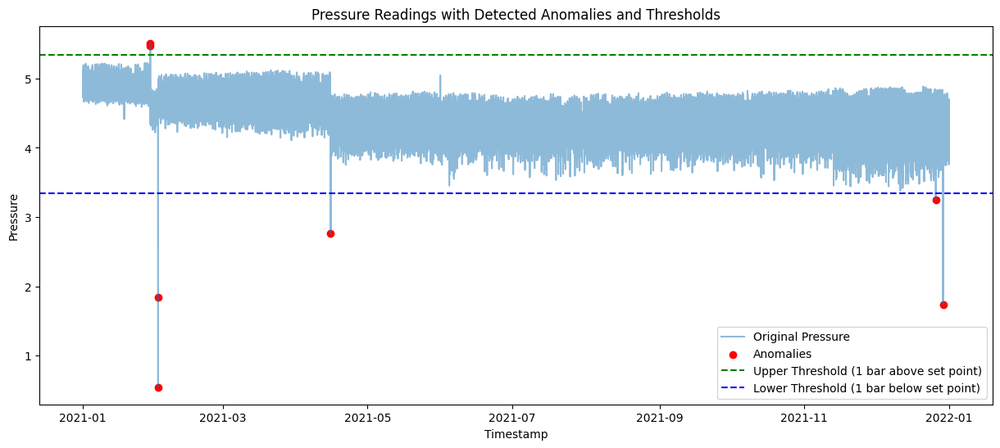

Set Point: 4.337806401643991
Suma Total de Anomalías: 7


In [211]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculating the mean within the correct range as set point
set_point = df.loc['2021-05-01':'2022-01-01', 'Pressure'].mean()

# Defining operational thresholds
upper_threshold = set_point + 1  # 1 bar above the set point
lower_threshold = set_point - 1  # 1 bar below the set point
df = df.dropna()
# Identifying points outside the threshold
df['Anomalies'] = ((df['Pressure'] > upper_threshold) | (df['Pressure'] < lower_threshold))

# Plotting the results with threshold lines
plt.figure(figsize=(15, 6))
plt.plot(df.index, df['Pressure'], label='Original Pressure', alpha=0.5)

# Highlight the anomalies
anomalies = df[df['Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='red', label='Anomalies')

# Add horizontal lines for the upper and lower threshold
plt.axhline(y=upper_threshold, color='green', linestyle='--', label='Upper Threshold (1 bar above set point)')
plt.axhline(y=lower_threshold, color='blue', linestyle='--', label='Lower Threshold (1 bar below set point)')

plt.title('Pressure Readings with Detected Anomalies and Thresholds')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()

# Print the set point for reference
print("Set Point:", set_point)
suma_anomalias = df['Anomalies'].sum()

print(f"Suma Total de Anomalías: {suma_anomalias}")

Epoch 1/50
221/221 [==============================] - 1s 2ms/step - loss: 0.8825 - val_loss: 1.4704
Epoch 2/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8825 - val_loss: 1.4704
Epoch 3/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8825 - val_loss: 1.4703
Epoch 4/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8825 - val_loss: 1.4703
Epoch 5/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8824 - val_loss: 1.4703
Epoch 6/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8824 - val_loss: 1.4703
Epoch 7/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8824 - val_loss: 1.4703
Epoch 8/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8824 - val_loss: 1.4703
Epoch 9/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8824 - val_loss: 1.4703
Epoch 10/50
221/221 [==============================] - 0s 1ms/step - loss: 0.8824 - val_loss: 1.4703

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\1748735659.py:81: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\1748735659.py:82: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



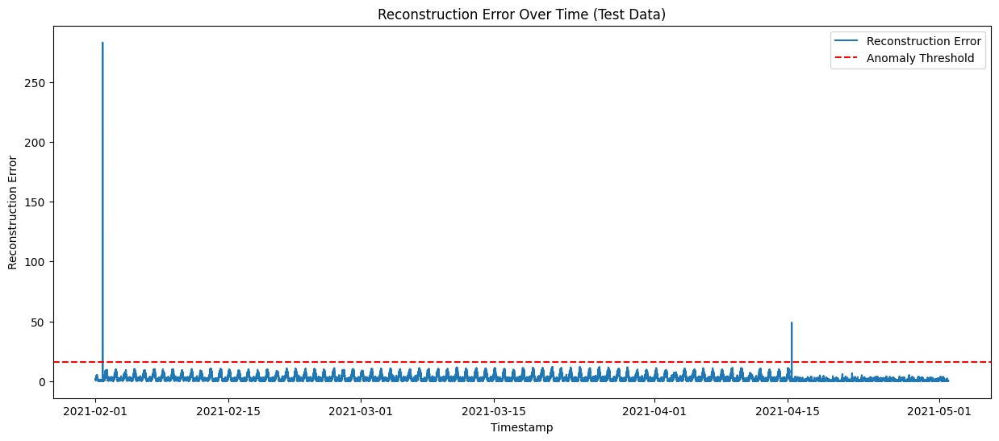

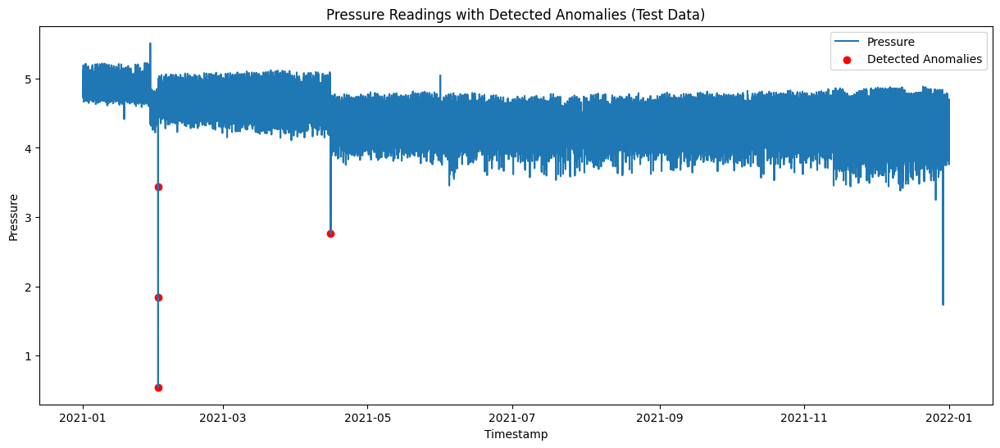

In [212]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score, confusion_matrix
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2021-05-01':'2022-01-01']
val_data = resampled_df['2021-01-01':'2023-02-01']
test_data = resampled_df['2021-02-01':'2021-05-01']

scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])


val_pressure_scaled = scaler.transform(val_data[['Pressure']])
test_pressure_scaled = scaler.transform(test_data[['Pressure']])


input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2 

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the validation set and calculate MSE
val_predictions = autoencoder.predict(val_pressure_scaled)
val_mse = np.mean(np.power(val_pressure_scaled - val_predictions, 2), axis=1)

# Extract true labels for the same range as val_data
true_labels = df.loc[val_data.index, 'Anomalies'].values

# Define a range of potential quantiles to search
quantiles = np.linspace(0.80, 0.9999, 100)

best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    threshold = np.quantile(val_mse, quantile)
    predicted_anomalies = val_mse > threshold

    # Calculate the F1 score
    f1 = f1_score(true_labels, predicted_anomalies)
    
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")

# Use the best quantile to set the mse_threshold on the test set
best_mse_threshold = np.quantile(val_mse, best_quantile)

# Predict on the test set
test_predictions = autoencoder.predict(test_pressure_scaled)
test_mse = np.mean(np.power(test_pressure_scaled - test_predictions, 2), axis=1)
test_data['Reconstruction_Error'] = test_mse
test_data['Predicted_Anomalies'] = test_mse > best_mse_threshold

plt.figure(figsize=(15, 6))
plt.plot(test_data.index, test_data['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=best_mse_threshold, color='r', linestyle='--', label='Anomaly Threshold')
plt.title('Reconstruction Error Over Time (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction Error')
plt.legend()
plt.show()

plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = test_data[test_data['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Detected Anomalies')
plt.title('Pressure Readings with Detected Anomalies (Test Data)')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()



In [213]:
import pandas as pd
from sklearn.metrics import confusion_matrix, precision_score, recall_score, f1_score, accuracy_score, matthews_corrcoef

test_true_labels = df.loc[test_data.index, 'Anomalies']

# Check if the shapes match
if test_true_labels.shape[0] != test_data.shape[0]:
    raise ValueError("Mismatch in the number of rows between test data and true labels.")

# Ensure binary format and handle NaN values
test_true_labels = test_true_labels.fillna(0).astype(int)
test_data['Predicted_Anomalies'] = test_data['Predicted_Anomalies'].fillna(0).astype(int)

TN, FP, FN, TP = confusion_matrix(test_true_labels, test_data['Predicted_Anomalies']).ravel()

precision = precision_score(test_true_labels, test_data['Predicted_Anomalies'])
recall = recall_score(test_true_labels, test_data['Predicted_Anomalies'])
f1 = f1_score(test_true_labels, test_data['Predicted_Anomalies'])
accuracy = accuracy_score(test_true_labels, test_data['Predicted_Anomalies'])
mcc = matthews_corrcoef(test_true_labels, test_data['Predicted_Anomalies'])
error_rate = (FP + FN) / (TP + FP + FN + TN)

print("Confusion Matrix:")
print(f"True Positives (TP): {TP}")
print(f"False Positives (FP): {FP}")
print(f"True Negatives (TN): {TN}")
print(f"False Negatives (FN): {FN}")
print("\nMetrics:")
print(f"Precision: {precision:.2f}")
print(f"Recall: {recall:.2f}")
print(f"F1 Score: {f1:.2f}")
print(f"Accuracy: {accuracy:.2f}")
print(f"Matthews Correlation Coefficient (MCC): {mcc:.2f}")
print(f"Error Rate: {error_rate:.2f}")

sum_true_anomalies = test_true_labels.sum()
sum_predicted_anomalies = test_data['Predicted_Anomalies'].sum()

print(f"Sum of True Anomalies in Test Range: {sum_true_anomalies}")
print(f"Sum of Predicted Anomalies in Test Range: {sum_predicted_anomalies}")


Confusion Matrix:
True Positives (TP): 3
False Positives (FP): 1
True Negatives (TN): 25904
False Negatives (FN): 0

Metrics:
Precision: 0.75
Recall: 1.00
F1 Score: 0.86
Accuracy: 1.00
Matthews Correlation Coefficient (MCC): 0.87
Error Rate: 0.00
Sum of True Anomalies in Test Range: 3
Sum of Predicted Anomalies in Test Range: 4


C:\Users\mikel\AppData\Local\Temp\ipykernel_11820\2913829944.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [214]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
# Drop rows with NaN values in resampled_df
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2021-05-01':'2022-01-01']

# Scale the 'Pressure' values of normal_data
scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])

joblib.dump(scaler, 'scaler_reductor3.save')

['scaler_reductor3.save']

Epoch 1/50
221/221 [==============================] - 1s 2ms/step - loss: 0.5104 - val_loss: 0.7836
Epoch 2/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4566 - val_loss: 0.7473
Epoch 3/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4488 - val_loss: 0.7352
Epoch 4/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4470 - val_loss: 0.7301
Epoch 5/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4461 - val_loss: 0.7266
Epoch 6/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4453 - val_loss: 0.7244
Epoch 7/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4447 - val_loss: 0.7217
Epoch 8/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4442 - val_loss: 0.7195
Epoch 9/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4437 - val_loss: 0.7176
Epoch 10/50
221/221 [==============================] - 0s 1ms/step - loss: 0.4433 - val_loss: 0.7160

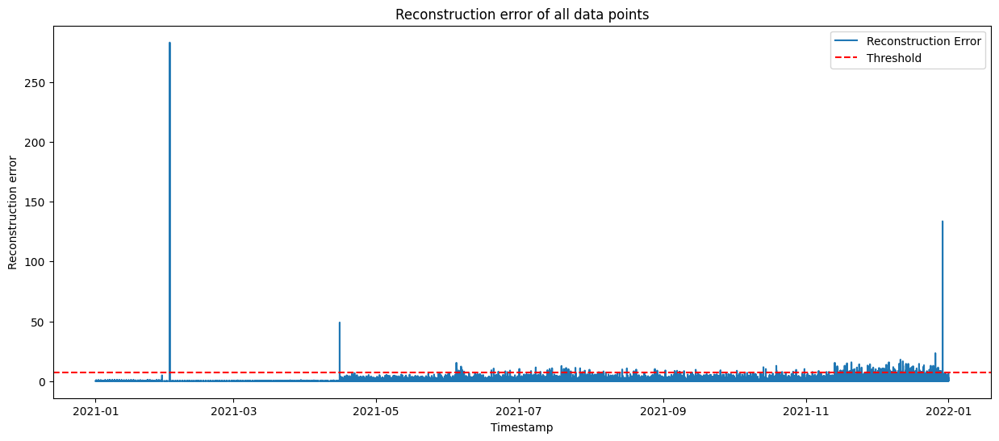

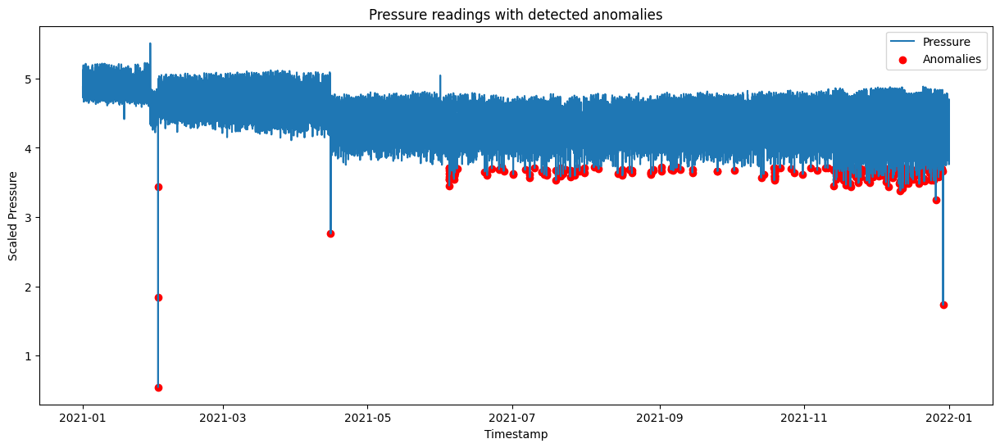

In [215]:
# Scale the entire resampled dataset using the parameters from normal_data
pressure_scaled = scaler.transform(resampled_df[['Pressure']])

# Define the autoencoder network
input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2  # This is the size of our encoded representations

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and fit the autoencoder
autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the entire resampled and scaled dataset
predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)
resampled_df['Reconstruction_Error'] = mse

# Set a threshold for anomaly detection
mse_threshold = np.quantile(resampled_df['Reconstruction_Error'], 0.9971) # Adjust the quantile value as needed

# Flag data points as anomalies
resampled_df['Predicted_Anomalies'] = resampled_df['Reconstruction_Error'] > mse_threshold

# Plot reconstruction error over time
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=mse_threshold, color='r', linestyle='--', label='Threshold')
plt.title('Reconstruction error of all data points')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction error')
plt.legend()
plt.show()

# Plot original data with anomalies marked
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [216]:
autoencoder.save('model_reductor3.h5')

c:\Users\mikel\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [217]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))


precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 0.017241379310344827
Recall / Sensitivity: 0.7142857142857143
F1 Score: 0.03367003367003367
False Positive Rate: 0.0027117031398667937
True Negative Rate: 0.9972882968601332
Specificity: 0.9972882968601332
Matthews Correlation Coefficient: 0.11070203240816076
Accuracy: 0.9972694492279296
Error: 0.0027305507720703664
Suma Total de Anomalías: 7
Suma Total de Anomalías Predecidas: 290


In [218]:
from sklearn.metrics import f1_score, confusion_matrix
import numpy as np

# True labels
true_labels = df['Anomalies'].values

predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)

# Define a range of potential quantiles to search
quantiles = np.linspace(0.90, 0.9999, 100)

# Store the best quantile value and its corresponding F1 score
best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    # Calculate threshold for the current quantile
    threshold = np.quantile(mse, quantile)
    # Predict anomalies using the calculated threshold
    predicted_anomalies = mse > threshold
    # Calculate the F1 score comparing the true labels with the predicted anomalies
    f1 = f1_score(true_labels, predicted_anomalies)
    
    # If the current F1 score is better than the best one so far, update the best score and quantile
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

print(f"Best quantile: {best_quantile}")
print(f"Best F1 score: {best_f1_score}")
print(f"Confusion Matrix at Best Quantile:\n{best_confusion_matrix}")

# Use the best quantile to set the mse_threshold
best_mse_threshold = np.quantile(mse, best_quantile)
print(f"Best MSE Threshold: {best_mse_threshold}")

# Flag data points as anomalies using the best threshold
resampled_df['Predicted_Anomalies'] = mse > best_mse_threshold


3285/3285 [==============================] - 2s 643us/step
Best quantile: 0.9999
Best F1 score: 0.5555555555555556
Confusion Matrix at Best Quantile:
[[105094      6]
 [     2      5]]
Best MSE Threshold: 15.353448746564641


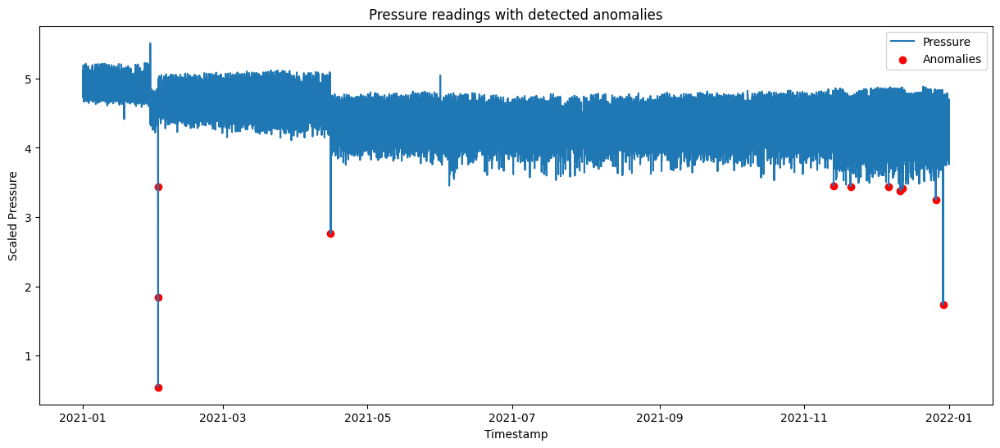

In [219]:
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [220]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))

precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 0.45454545454545453
Recall / Sensitivity: 0.7142857142857143
F1 Score: 0.5555555555555556
False Positive Rate: 5.708848715509039e-05
True Negative Rate: 0.9999429115128449
Specificity: 0.9999429115128449
Matthews Correlation Coefficient: 0.5697681839442335
Accuracy: 0.9999238870864928
Error: 7.611291350718791e-05
Suma Total de Anomalías: 7
Suma Total de Anomalías Predecidas: 11


We can see the improvement

In [221]:
# Define thresholds for severity levels based on percentiles
severity_thresholds = {
    'mild': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.75),
    'moderate': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.90),
    'severe': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.99)
}

# Function to classify anomaly severity
def classify_anomaly_severity(row):
    if row['Predicted_Anomalies']:
        if row['Reconstruction_Error'] <= severity_thresholds['mild']:
            return 'Mild'
        elif row['Reconstruction_Error'] <= severity_thresholds['moderate']:
            return 'Moderate'
        else:
            return 'Severe'
    else:
        return 'Normal'

# Apply the classification function
resampled_df['Anomaly_Severity'] = resampled_df.apply(classify_anomaly_severity, axis=1)



In [222]:
import plotly.graph_objects as go
import nbformat

fig = go.Figure()

# Plot the normal pressure readings
fig.add_trace(go.Scatter(x=resampled_df.index, y=resampled_df['Pressure'], mode='lines', name='Pressure'))

# Separate the anomalies based on severity
mild_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Mild']
moderate_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Moderate']
severe_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Severe']

# Add traces for anomalies with different colors
fig.add_trace(go.Scatter(x=mild_anomalies.index, y=mild_anomalies['Pressure'], mode='markers', name='Mild Anomalies', marker_color='yellow'))
fig.add_trace(go.Scatter(x=moderate_anomalies.index, y=moderate_anomalies['Pressure'], mode='markers', name='Moderate Anomalies', marker_color='orange'))
fig.add_trace(go.Scatter(x=severe_anomalies.index, y=severe_anomalies['Pressure'], mode='markers', name='Severe Anomalies', marker_color='red'))

# Add title and labels
fig.update_layout(title='Pressure readings with detected anomalies', xaxis_title='Timestamp', yaxis_title='Scaled Pressure')


fig.show()


In [223]:
import mysql.connector

df = pd.read_csv('Asteasu_industrialdea_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp']).dt.strftime('%Y-%m-%d %H:%M:%S')  # Format for MySQL

db_config = {
    'host': '127.0.0.1',
    'port': 3306,
    'user': 'admin',
    'password': 'admin@eskola',
    'database': 'aiqua'
}

with mysql.connector.connect(**db_config) as conn:
    with conn.cursor() as cursor:
        # Prepare the insert statement
        query = """
        INSERT INTO data (timestamp, flow, pressure, reductorID)
        VALUES (%s, %s, %s, %s)
        """
        
        # Prepare the data for insertion
        values = df.drop(columns=['ID', 'Unknown']).assign(reductorID=3).values.tolist()
        
        # Define a smaller batch size if necessary
        batch_size = 500
        for start in range(0, len(values), batch_size):
            end = start + batch_size
            batch_values = values[start:end]
            try:
                cursor.executemany(query, batch_values)
                conn.commit()  # Commit after each batch
            except mysql.connector.Error as err:
                print("Error: {}".format(err))
                conn.rollback()  # Rollback in case of error

## IRURA

In [224]:
import pandas as pd

df = pd.read_csv('IRURA_KATATEGI_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp'])
df = df.drop(['ID', 'Flow', 'Unknown'], axis=1)
df.head()

,Timestamp,Pressure
0,2021-01-01 00:05:00,4.126
1,2021-01-01 00:05:00,4.420
2,2021-01-01 00:05:00,4.261
3,2021-01-01 00:10:00,3.919
4,2021-01-01 00:10:00,3.919


In [225]:
# Setting the timestamp as the index
df.set_index('Timestamp', inplace=True)

# Resampling the data to a 5-minute interval using mean
df = df.resample('5T').mean()

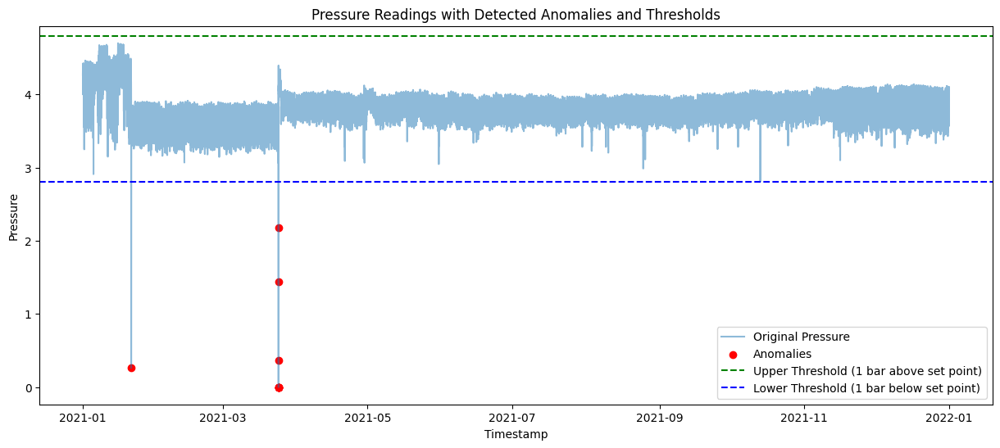

Set Point: 3.8036310084541065
Suma Total de Anomalías: 9


In [226]:
import pandas as pd
import matplotlib.pyplot as plt

# Calculating the mean within the correct range as set point
set_point = df.loc['2021-07-01':'2022-01-01', 'Pressure'].mean()

# Defining operational thresholds
upper_threshold = set_point + 1  # 1 bar above the set point
lower_threshold = set_point - 1  # 1 bar below the set point
df = df.dropna()
# Identifying points outside the threshold
df['Anomalies'] = ((df['Pressure'] > upper_threshold) | (df['Pressure'] < lower_threshold))

# Plotting the results with threshold lines
plt.figure(figsize=(15, 6))
plt.plot(df.index, df['Pressure'], label='Original Pressure', alpha=0.5)

# Highlight the anomalies
anomalies = df[df['Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='red', label='Anomalies')

# Add horizontal lines for the upper and lower threshold
plt.axhline(y=upper_threshold, color='green', linestyle='--', label='Upper Threshold (1 bar above set point)')
plt.axhline(y=lower_threshold, color='blue', linestyle='--', label='Lower Threshold (1 bar below set point)')

plt.title('Pressure Readings with Detected Anomalies and Thresholds')
plt.xlabel('Timestamp')
plt.ylabel('Pressure')
plt.legend()
plt.show()

# Print the set point for reference
print("Set Point:", set_point)
suma_anomalias = df['Anomalies'].sum()

print(f"Suma Total de Anomalías: {suma_anomalias}")

In [227]:
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Dense
from tensorflow.keras import regularizers
import matplotlib.pyplot as plt
import joblib

resampled_df = df.resample('5T').mean()
# Drop rows with NaN values in resampled_df
resampled_df = resampled_df.dropna()

normal_data = resampled_df['2021-07-01':'2022-01-01']

# Scale the 'Pressure' values of normal_data
scaler = StandardScaler()
normal_pressure_scaled = scaler.fit_transform(normal_data[['Pressure']])

joblib.dump(scaler, 'scaler_reductor4.save')

['scaler_reductor4.save']

Epoch 1/50
166/166 [==============================] - 1s 2ms/step - loss: 0.8017 - val_loss: 1.7936
Epoch 2/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8017 - val_loss: 1.7935
Epoch 3/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8017 - val_loss: 1.7935
Epoch 4/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8017 - val_loss: 1.7935
Epoch 5/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8017 - val_loss: 1.7935
Epoch 6/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8016 - val_loss: 1.7934
Epoch 7/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8016 - val_loss: 1.7934
Epoch 8/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8016 - val_loss: 1.7934
Epoch 9/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8016 - val_loss: 1.7934
Epoch 10/50
166/166 [==============================] - 0s 1ms/step - loss: 0.8016 - val_loss: 1.7934

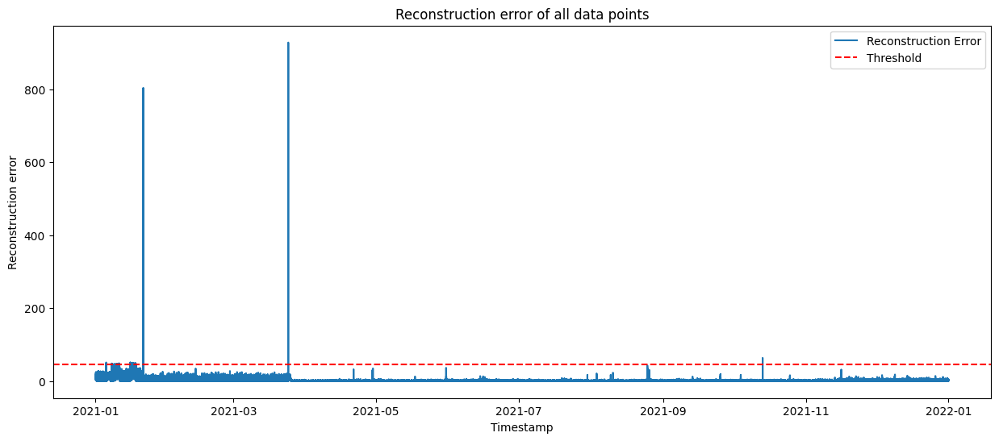

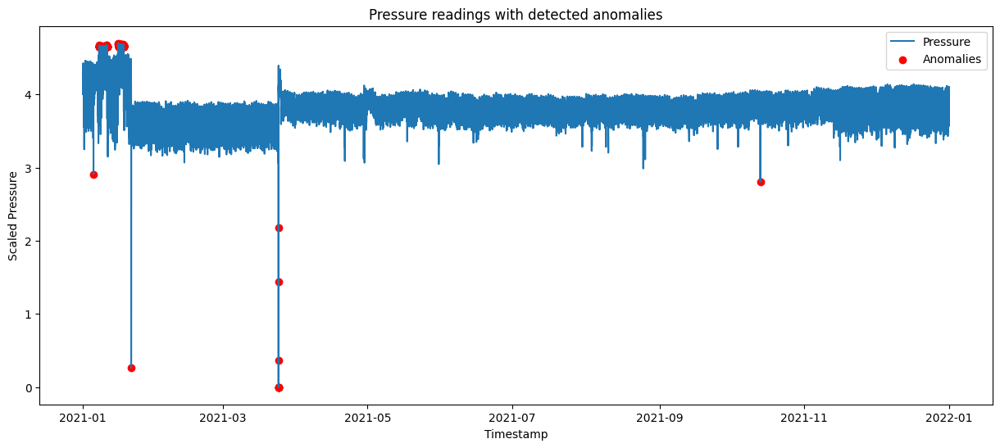

In [228]:
# Scale the entire resampled dataset using the parameters from normal_data
pressure_scaled = scaler.transform(resampled_df[['Pressure']])

# Define the autoencoder network
input_dim = normal_pressure_scaled.shape[1]
encoding_dim = 2  # This is the size of our encoded representations

input_layer = Input(shape=(input_dim,))
encoder = Dense(encoding_dim, activation="tanh", 
                activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(int(encoding_dim / 2), activation="relu")(encoder)
decoder = Dense(int(encoding_dim / 2), activation='tanh')(encoder)
decoder = Dense(input_dim, activation='relu')(decoder)

autoencoder = Model(inputs=input_layer, outputs=decoder)

# Compile and fit the autoencoder
autoencoder.compile(optimizer='adam', loss='mean_squared_error')
autoencoder.fit(normal_pressure_scaled, normal_pressure_scaled,
                epochs=50,
                batch_size=256,
                shuffle=True,
                validation_split=0.2,
                verbose=1)

# Predict on the entire resampled and scaled dataset
predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)
resampled_df['Reconstruction_Error'] = mse

# Set a threshold for anomaly detection
mse_threshold = np.quantile(resampled_df['Reconstruction_Error'], 0.9971) # Adjust the quantile value as needed

# Flag data points as anomalies
resampled_df['Predicted_Anomalies'] = resampled_df['Reconstruction_Error'] > mse_threshold

# Plot reconstruction error over time
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Reconstruction_Error'], label='Reconstruction Error')
plt.axhline(y=mse_threshold, color='r', linestyle='--', label='Threshold')
plt.title('Reconstruction error of all data points')
plt.xlabel('Timestamp')
plt.ylabel('Reconstruction error')
plt.legend()
plt.show()

# Plot original data with anomalies marked
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [229]:
autoencoder.save('model_reductor4.h5')

c:\Users\mikel\AppData\Local\Programs\Python\Python311\Lib\site-packages\keras\src\engine\training.py:3103: UserWarning:

You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.



In [230]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))

precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0

print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 0.030303030303030304
Recall / Sensitivity: 1.0
F1 Score: 0.05882352941176471
False Positive Rate: 0.0027402995299625112
True Negative Rate: 0.9972597004700375
Specificity: 0.9972597004700375
Matthews Correlation Coefficient: 0.17383897987314142
Accuracy: 0.9972599351137412
Error: 0.0027400648862587647
Suma Total de Anomalías: 9
Suma Total de Anomalías Predecidas: 297


In [231]:
from sklearn.metrics import f1_score, confusion_matrix
import numpy as np

# True labels
true_labels = df['Anomalies'].values

predictions = autoencoder.predict(pressure_scaled)
mse = np.mean(np.power(pressure_scaled - predictions, 2), axis=1)

# Define a range of potential quantiles to search
quantiles = np.linspace(0.90, 0.9999, 100)

# Store the best quantile value and its corresponding F1 score
best_quantile = None
best_f1_score = 0
best_confusion_matrix = None

# Search for the best quantile
for quantile in quantiles:
    # Calculate threshold for the current quantile
    threshold = np.quantile(mse, quantile)
    # Predict anomalies using the calculated threshold
    predicted_anomalies = mse > threshold
    # Calculate the F1 score comparing the true labels with the predicted anomalies
    f1 = f1_score(true_labels, predicted_anomalies)
    
    # If the current F1 score is better than the best one so far, update the best score and quantile
    if f1 > best_f1_score:
        best_f1_score = f1
        best_quantile = quantile
        best_confusion_matrix = confusion_matrix(true_labels, predicted_anomalies)

# Output the results
print(f"Best quantile: {best_quantile}")
print(f"Best F1 score: {best_f1_score}")
print(f"Confusion Matrix at Best Quantile:\n{best_confusion_matrix}")

# Use the best quantile to set the mse_threshold
best_mse_threshold = np.quantile(mse, best_quantile)
print(f"Best MSE Threshold: {best_mse_threshold}")

# Flag data points as anomalies using the best threshold
resampled_df['Predicted_Anomalies'] = mse > best_mse_threshold


3285/3285 [==============================] - 2s 643us/step
Best quantile: 0.9999
Best F1 score: 0.9
Confusion Matrix at Best Quantile:
[[105096      2]
 [     0      9]]
Best MSE Threshold: 51.3898535519768


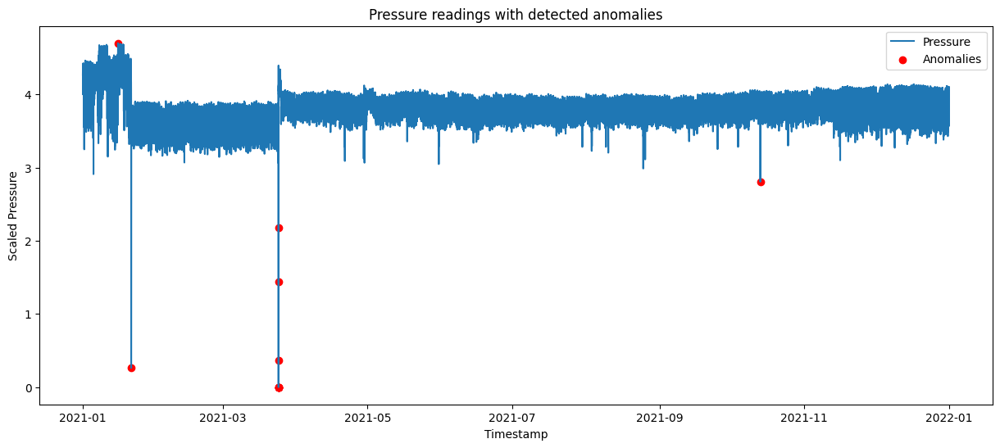

In [232]:
plt.figure(figsize=(15, 6))
plt.plot(resampled_df.index, resampled_df['Pressure'], label='Pressure')
anomalies = resampled_df[resampled_df['Predicted_Anomalies']]
plt.scatter(anomalies.index, anomalies['Pressure'], color='r', label='Anomalies')
plt.title('Pressure readings with detected anomalies')
plt.xlabel('Timestamp')
plt.ylabel('Scaled Pressure')
plt.legend()
plt.show()

In [233]:
# Define thresholds for severity levels based on percentiles
severity_thresholds = {
    'mild': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.75),
    'moderate': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.90),
    'severe': np.quantile(resampled_df[resampled_df['Predicted_Anomalies']]['Reconstruction_Error'], 0.99)
}

# Function to classify anomaly severity
def classify_anomaly_severity(row):
    if row['Predicted_Anomalies']:
        if row['Reconstruction_Error'] <= severity_thresholds['mild']:
            return 'Mild'
        elif row['Reconstruction_Error'] <= severity_thresholds['moderate']:
            return 'Moderate'
        else:
            return 'Severe'
    else:
        return 'Normal'

# Apply the classification function
resampled_df['Anomaly_Severity'] = resampled_df.apply(classify_anomaly_severity, axis=1)



In [234]:
import plotly.graph_objects as go
import nbformat

fig = go.Figure()

# Plot the normal pressure readings
fig.add_trace(go.Scatter(x=resampled_df.index, y=resampled_df['Pressure'], mode='lines', name='Pressure'))

# Separate the anomalies based on severity
mild_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Mild']
moderate_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Moderate']
severe_anomalies = resampled_df[resampled_df['Anomaly_Severity'] == 'Severe']

# Add traces for anomalies with different colors
fig.add_trace(go.Scatter(x=mild_anomalies.index, y=mild_anomalies['Pressure'], mode='markers', name='Mild Anomalies', marker_color='yellow'))
fig.add_trace(go.Scatter(x=moderate_anomalies.index, y=moderate_anomalies['Pressure'], mode='markers', name='Moderate Anomalies', marker_color='orange'))
fig.add_trace(go.Scatter(x=severe_anomalies.index, y=severe_anomalies['Pressure'], mode='markers', name='Severe Anomalies', marker_color='red'))

# Add title and labels
fig.update_layout(title='Pressure readings with detected anomalies', xaxis_title='Timestamp', yaxis_title='Scaled Pressure')


fig.show()


In [235]:

TP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == True))
FP = sum((resampled_df['Predicted_Anomalies'] == 1) & (df['Anomalies'] == False))
FN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == True))
TN = sum((resampled_df['Predicted_Anomalies'] == 0) & (df['Anomalies'] == False))


precision = TP / (TP + FP) if TP + FP > 0 else 0
recall = TP / (TP + FN) if TP + FN > 0 else 0
f1_score = 2 * (precision * recall) / (precision + recall) if precision + recall > 0 else 0
fpr = FP / (FP + TN) if FP + TN > 0 else 0
tnr = TN / (TN + FP) if TN + FP > 0 else 0
spc = TN / (TN + FP) if TN + FP > 0 else 0
mcc = ((TP * TN) - (FP * FN)) / np.sqrt((TP+FP) * (TP+FN) * (TN+FP) * (TN+FN)) if (TP+FP) * (TP+FN) * (TN+FP) * (TN+FN) > 0 else 0
acc = (TP + TN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0
err = (FP + FN) / (TP + FP + FN + TN) if TP + FP + FN + TN > 0 else 0


print(f"Precision: {precision}")
print(f"Recall / Sensitivity: {recall}")
print(f"F1 Score: {f1_score}")
print(f"False Positive Rate: {fpr}")
print(f"True Negative Rate: {tnr}")
print(f"Specificity: {spc}")
print(f"Matthews Correlation Coefficient: {mcc}")
print(f"Accuracy: {acc}")
print(f"Error: {err}")
suma_anomalias = df['Anomalies'].sum()
suma_anomalias_predecidas = resampled_df['Predicted_Anomalies'].sum()
print(f"Suma Total de Anomalías: {suma_anomalias}")
print(f"Suma Total de Anomalías Predecidas: {suma_anomalias_predecidas}")


Precision: 0.8181818181818182
Recall / Sensitivity: 1.0
F1 Score: 0.9
False Positive Rate: 1.9029857846961882e-05
True Negative Rate: 0.999980970142153
Specificity: 0.999980970142153
Matthews Correlation Coefficient: 0.9045254271153051
Accuracy: 0.9999809717716232
Error: 1.9028228376796977e-05
Suma Total de Anomalías: 9
Suma Total de Anomalías Predecidas: 11


In [236]:
import mysql.connector

df = pd.read_csv('IRURA_KATATEGI_2021.csv', delimiter=';')
df.columns = ['ID', 'Timestamp', 'Flow', 'Unknown', 'Pressure']
df['Timestamp'] = pd.to_datetime(df['Timestamp']).dt.strftime('%Y-%m-%d %H:%M:%S')  # Format for MySQL

db_config = {
    'host': '127.0.0.1',
    'port': 3306,
    'user': 'admin',
    'password': 'admin@eskola',
    'database': 'aiqua'
}

with mysql.connector.connect(**db_config) as conn:
    with conn.cursor() as cursor:
        # Prepare the insert statement
        query = """
        INSERT INTO data (timestamp, flow, pressure, reductorID)
        VALUES (%s, %s, %s, %s)
        """
        
        # Prepare the data for insertion
        values = df.drop(columns=['ID', 'Unknown']).assign(reductorID=4).values.tolist()
        
        # Define a smaller batch size if necessary
        batch_size = 500
        for start in range(0, len(values), batch_size):
            end = start + batch_size
            batch_values = values[start:end]
            try:
                cursor.executemany(query, batch_values)
                conn.commit()  # Commit after each batch
            except mysql.connector.Error as err:
                print("Error: {}".format(err))
                conn.rollback()  # Rollback in case of error